<a href="https://www.kaggle.com/code/saskiadwiulfah18/segment-anything-model-for-brain-mri-segmentation?scriptVersionId=155363687" target="_blank"><img align="left" alt="Kaggle" title="Open in Kaggle" src="https://kaggle.com/static/images/open-in-kaggle.svg"></a>

In [1]:
!pip install datasets

In [2]:
!pip install monai

  Obtaining dependency information for monai from https://files.pythonhosted.org/packages/08/94/e8a7ba00dd0c7ce959648b562043bd22125d65f5e519e566c822f71bc437/monai-1.3.0-202310121228-py3-none-any.whl.metadata
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.3/1.3 MB 15.6 MB/s eta 0:00:00


In [3]:
import random
import os
import glob
import time
import warnings
import io

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches
import seaborn as sns
# import opendatasets as od
import datasets as dts

from PIL import Image
from IPython.display import clear_output
from tqdm.notebook import tqdm
from typing import Dict, List, Tuple
from statistics import mean


import torch
import monai
import cv2
import torchvision
import torch.optim.lr_scheduler as lr_scheduler
from torch import nn
from torch.utils.data import DataLoader
from torch.optim import Adam
from torchvision import transforms
from monai.transforms import Compose, NormalizeIntensityd
from monai.metrics import compute_iou
from sklearn.model_selection import train_test_split

from transformers import SamProcessor
from transformers import SamModel

/opt/conda/lib/python3.10/site-packages/scipy/__init__.py:146: UserWarning: A NumPy version >=1.16.5 and <1.23.0 is required for this version of SciPy (detected version 1.24.3
  warnings.warn(f"A NumPy version >={np_minversion} and <{np_maxversion}"


# CONFIGURATION

In [4]:
plt.style.use("dark_background")
warnings.filterwarnings("ignore", "is_categorical_dtype")
warnings.filterwarnings("ignore", "use_inf_as_na")

In [5]:
class CFG:
    # define paths
    DATASET_PATH = "/kaggle/input/lgg-mri-segmentation/"
    TRAIN_PATH = "/kaggle/input/lgg-mri-segmentation/kaggle_3m/"
    
    DEVICE = "cuda" if torch.cuda.is_available() else "cpu"
    TRAIN_BATCH_SIZE = 2
    TEST_BATCH_SIZE = 1
    LEARNING_RATE = 1e-3
    WEIGHT_DECAY = 0
    EPOCH = 10

# DATA PREPARATION

In [6]:
dataset_images = glob.glob(f"{CFG.TRAIN_PATH}**/*.tif")
dataset_images[:5]

['/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_45.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_56_mask.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_57.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_33.tif',
 '/kaggle/input/lgg-mri-segmentation/kaggle_3m/TCGA_DU_7010_19860307/TCGA_DU_7010_19860307_27.tif']

In [7]:
def get_sample_patient_id(image_paths):
    return [(_.split('/')[-2:][0]) for _ in image_paths]

def get_sample_number(image_paths):
    sample_numbers = []
    is_mask = []

    for path in image_paths:
        path_list = path.split('/')[-2:][1].split('_')

        if 'mask.tif' in path_list:
            sample_numbers.append(int(path_list[-2]))
            is_mask.append(1)
        else:
            sample_numbers.append(int(path_list[-1].replace('.tif', '')))
            is_mask.append(0)

    return sample_numbers, is_mask

def build_df(image_paths):
    sample_numbers, mask_label = get_sample_number(image_paths)
    # create dataframe
    df = pd.DataFrame({
        'id'        : sample_numbers,
        'patient'   : get_sample_patient_id(image_paths),
        'image_path': image_paths,
        'is_mask'   : mask_label
    })

    # return df
    return df

In [8]:
# 0 = image
# 1 = mask

dataset_df = (
    build_df(dataset_images)
    .sort_values(by=['id', 'patient', 'image_path'])
    .reset_index(drop=True)
)

dataset_df

,id,patient,image_path,is_mask
0,1,TCGA_CS_4941_19960909,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
1,1,TCGA_CS_4941_19960909,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,1
2,1,TCGA_CS_4942_19970222,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
3,1,TCGA_CS_4942_19970222,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,1
4,1,TCGA_CS_4943_20000902,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
...,...,...,...,...
7853,87,TCGA_HT_A61B_19991127,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,1
7854,88,TCGA_HT_A61A_20000127,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
7855,88,TCGA_HT_A61A_20000127,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,1
7856,88,TCGA_HT_A61B_19991127,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0


In [9]:
# images_df: for images
# mask_df: for masks

grouped_df = dataset_df.groupby(by='is_mask')
images_df, mask_df = (
    grouped_df.get_group(0).drop('is_mask', axis=1).reset_index(drop=True),
    grouped_df.get_group(1).drop('is_mask', axis=1).reset_index(drop=True)
)

mask_df = mask_df.rename({'image_path': 'mask_path'}, axis=1)

mask_df.head()

,id,patient,mask_path
0,1,TCGA_CS_4941_19960909,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...
1,1,TCGA_CS_4942_19970222,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...
2,1,TCGA_CS_4943_20000902,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...
3,1,TCGA_CS_4944_20010208,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...
4,1,TCGA_CS_5393_19990606,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...


In [10]:
def _load(image_path, as_tensor=True):
    image = Image.open(image_path)
    return np.array(image).astype(np.float32) / 255.

def generate_label(mask_path, load_fn):
    mask = load_fn(mask_path)
    if mask.max() > 0:
        return 1 # Brain Tumor Present
    return 0 # Normal

In [11]:
# merge images dataframe and masks dataframe
ds = images_df.merge(
    mask_df,
    on=['id', 'patient'],
    how='left'
)

# generate MRI Label
ds['diagnosis'] = [generate_label(_, _load) for _ in tqdm(ds['mask_path'])]
ds.head()

  0%|          | 0/3929 [00:00<?, ?it/s]

,id,patient,image_path,mask_path,diagnosis
0,1,TCGA_CS_4941_19960909,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
1,1,TCGA_CS_4942_19970222,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
2,1,TCGA_CS_4943_20000902,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
3,1,TCGA_CS_4944_20010208,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0
4,1,TCGA_CS_5393_19990606,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,/kaggle/input/lgg-mri-segmentation/kaggle_3m/T...,0


In [12]:
# filter valid masks and choose only 1360
ds = ds[ds['diagnosis']==1]
ds = ds.head(1360)

In [13]:
image_train, image_test, mask_train, mask_test = train_test_split(
ds['image_path'], ds['mask_path'], test_size = 0.10)

In [14]:
train_df = pd.concat([image_train, mask_train], axis=1).reset_index(drop=True)
train_dataset = dts.Dataset.from_pandas(train_df)

In [15]:
test_df = pd.concat([image_test, mask_test], axis=1).reset_index(drop=True)
test_dataset = dts.Dataset.from_pandas(test_df)

In [16]:
def transform(data):
    # Load the image
    with open(data['image_path'], 'rb') as f:
        image = Image.open(io.BytesIO(f.read())).convert('RGB')
    data['image'] = image

    with open(data['mask_path'], 'rb') as f:
        mask = Image.open(io.BytesIO(f.read())).convert('L') # to grayscale
    data['mask'] = mask

    return data

In [17]:
train_dataset = train_dataset.map(transform, remove_columns=['image_path','mask_path'])

  0%|          | 0/1224 [00:00<?, ?ex/s]

In [18]:
train_dataset

Dataset({
    features: ['image', 'mask'],
    num_rows: 1224
})

In [19]:
test_dataset = test_dataset.map(transform, remove_columns=['image_path','mask_path'])

  0%|          | 0/136 [00:00<?, ?ex/s]

In [20]:
test_dataset

Dataset({
    features: ['image', 'mask'],
    num_rows: 136
})

In [21]:
example = train_dataset[0]
img = example['image']
msk = example['mask']

In [22]:
np.array(msk).max(), np.array(msk).min(), np.array(img).max(), np.array(img).min()

(255, 0, 187, 0)

In [23]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([30/255, 144/255, 255/255, 0.6])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

(-0.5, 255.5, 255.5, -0.5)

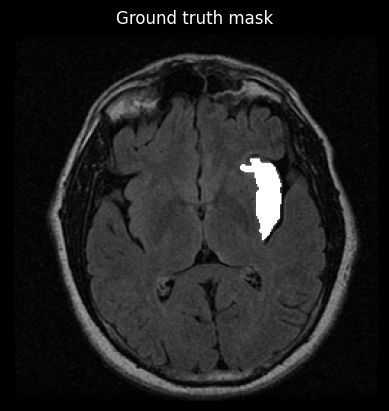

In [24]:
fig, axes = plt.subplots()

axes.imshow(np.array(img))
ground_truth_seg = np.array(example["mask"])
show_mask(ground_truth_seg, axes)
axes.title.set_text(f"Ground truth mask")
axes.axis("off")

In [25]:
def get_bounding_box(ground_truth_map):
    '''
    This function creates varying bounding box coordinates based on the segmentation contours as prompt for the SAM model
    The padding is random int values between 5 and 20 pixels
    '''

    if len(np.unique(ground_truth_map)) > 1:

        # get bounding box from mask
        y_indices, x_indices = np.where(ground_truth_map > 0)
        x_min, x_max = np.min(x_indices), np.max(x_indices)
        y_min, y_max = np.min(y_indices), np.max(y_indices)

        # add perturbation to bounding box coordinates
        H, W = ground_truth_map.shape
        x_min = max(0, x_min - np.random.randint(5, 20))
        x_max = min(W, x_max + np.random.randint(5, 20))
        y_min = max(0, y_min - np.random.randint(5, 20))
        y_max = min(H, y_max + np.random.randint(5, 20))

        bbox = [x_min, y_min, x_max, y_max]

        return bbox
    else:
        return [0, 0, 256, 256]

In [26]:
class SAMDataset(torch.utils.data.Dataset):
  def __init__(self, dataset, processor):
    self.dataset = dataset
    self.processor = processor
    #self.transforms = transforms = Compose([NormalizeIntensityd(divisor=255, keys=['mask'])])

  def __len__(self):
    return len(self.dataset)

  def __getitem__(self, idx):
    item = self.dataset[idx]
    image = item["image"]
    ground_truth_mask = np.array(item["mask"])
    # ground_truth_mask = item["mask"]

    # get bounding box prompt
    prompt = get_bounding_box(ground_truth_mask)

    # prepare image and prompt for the model
    inputs = self.processor(image, input_boxes=[[prompt]], return_tensors="pt")

    # remove batch dimension which the processor adds by default
    inputs = {k:v.squeeze(0) for k,v in inputs.items()}

    # add ground truth segmentation
    inputs["ground_truth_mask"] = ground_truth_mask/255

    return inputs

In [27]:
processor = SamProcessor.from_pretrained("facebook/sam-vit-base", do_normalize=False)

preprocessor_config.json:   0%|          | 0.00/466 [00:00<?, ?B/s]

In [28]:
train_sam_ds = SAMDataset(dataset=train_dataset, processor=processor)

In [29]:
exmpl = train_sam_ds[10]
for k,v in exmpl.items():
  print(k,v.shape)

pixel_values torch.Size([3, 1024, 1024])
original_sizes torch.Size([2])
reshaped_input_sizes torch.Size([2])
input_boxes torch.Size([1, 4])
ground_truth_mask (256, 256)


In [30]:
train_dataloader = DataLoader(train_sam_ds, batch_size=CFG.TRAIN_BATCH_SIZE, shuffle=False)

In [31]:
batch = next(iter(train_dataloader))
for k,v in batch.items():
  print(k,v.shape)

pixel_values torch.Size([2, 3, 1024, 1024])
original_sizes torch.Size([2, 2])
reshaped_input_sizes torch.Size([2, 2])
input_boxes torch.Size([2, 1, 4])
ground_truth_mask torch.Size([2, 256, 256])


In [32]:
train_df.shape

(1224, 2)

# Modeling

In [33]:
model = SamModel.from_pretrained("facebook/sam-vit-base")

# make sure we only compute gradients for mask decoder
for name, param in model.named_parameters():
  if name.startswith("vision_encoder") or name.startswith("prompt_encoder"):
    param.requires_grad_(False)

config.json:   0%|          | 0.00/6.57k [00:00<?, ?B/s]

pytorch_model.bin:   0%|          | 0.00/375M [00:00<?, ?B/s]

In [34]:
# Note: Hyperparameter tuning could improve performance here
optimizer = Adam(model.mask_decoder.parameters(), lr=CFG.LEARNING_RATE, weight_decay=CFG.WEIGHT_DECAY)
seg_loss = monai.losses.FocalLoss(reduction='mean')

In [35]:
num_epochs = CFG.EPOCH

device = CFG.DEVICE
model.to(device)

model.train()

epoch_losses = []
epoch_ious = []
# epoch_preds = []
# epoch_actls = []

for epoch in range(num_epochs):
    print(f'EPOCH: {epoch}')
    # menyimpan losses di setiap batch
    batch_losses = []
    # menyimpan iou di setiap batch
    batch_ious = []

    for i, batch in enumerate(tqdm(train_dataloader)):

      # forward pass
      outputs = model(pixel_values=batch["pixel_values"].to(device),
                      input_boxes=batch["input_boxes"].to(device),
                      multimask_output=False)

      # process the output
      predicted_masks = outputs.pred_masks.squeeze(1) # perlu diubah ke sigmoid
      ground_truth_masks = batch["ground_truth_mask"].float().to(device)

      sam_masks_prob = torch.sigmoid(predicted_masks)
      sam_masks_prob = sam_masks_prob.squeeze()
      sam_masks = (sam_masks_prob > 0.5)

      # compute loss
      loss = seg_loss(predicted_masks, ground_truth_masks.unsqueeze(1))
      batch_losses.append(loss.item())
      # batch_preds.append(predicted_masks)
      # batch_actls.append(ground_truth_masks.unsqueeze(1))

      # compute iou: return 2 values: 1 for each batch
      ious = compute_iou(sam_masks.unsqueeze(1),
                        ground_truth_masks.unsqueeze(1), ignore_empty=False)
      batch_ious.append(ious.mean())

      '''
      clear_output(wait=True)

      fig, axs = plt.subplots(1, 3)
      xmin, ymin, xmax, ymax = get_bounding_box(batch['ground_truth_mask'][0])
      rect = patches.Rectangle((xmin, ymin), xmax-xmin, ymax-ymin, linewidth=1, edgecolor='r', facecolor='none')

      axs[0].set_title('Input Image')
      axs[0].imshow(batch["pixel_values"][0,1], cmap='gray')
      axs[0].axis('off')

      axs[1].set_title('Actual Mask')
      axs[1].imshow(batch['ground_truth_mask'][0], cmap='copper')
      axs[1].add_patch(rect)
      axs[1].axis('off')

      # apply sigmoid
      medsam_seg_prob = torch.sigmoid(outputs.pred_masks[0].squeeze(1))

      # convert soft mask to hard mask
      medsam_seg_prob = medsam_seg_prob.detach().cpu().numpy().squeeze()
      medsam_seg = (medsam_seg_prob > 0.5).astype(np.uint8)

      axs[2].set_title('Predicted Mask')
      # axs[2].imshow(predicted_masks[0].cpu().detach().numpy().reshape(256,256,1)*255, cmap='copper')
      axs[2].imshow(medsam_seg, cmap='copper')
      axs[2].axis('off')

      plt.tight_layout()
      plt.show()
      '''

      # backward pass (compute gradients of parameters w.r.t. loss)
      optimizer.zero_grad()
      loss.backward()

      # optimize
      optimizer.step()

      if torch.cuda.is_available():
        torch.cuda.empty_cache()

    # epoch_preds.append(batch_preds)
    # epoch_actls.append(batch_actls)

    mean_loss = mean(batch_losses)
    epoch_losses.append(mean_loss)
    print(f'Mean loss: {mean_loss}')

    mean_iou = mean([t.cpu().item() for t in batch_ious])
    epoch_ious.append(mean_iou)
    print(f'Mean IoU: {mean_iou}')

# setiap batch: IoU-nya adalah rata2 dari 2 IoU (ada 2 batch size)
# setiap epoch: rata-rata dari IoU setiap batch

EPOCH: 0


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.014949875428939384
Mean IoU: 0.44253743652434957
EPOCH: 1


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.006584467562931298
Mean IoU: 0.5981104019877129
EPOCH: 2


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.006115340464234845
Mean IoU: 0.6282641243740644
EPOCH: 3


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.006239636539534081
Mean IoU: 0.6205547393476164
EPOCH: 4


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005298354951710459
Mean IoU: 0.655343701617847
EPOCH: 5


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.00544708269344661
Mean IoU: 0.6514780628951449
EPOCH: 6


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.00512638901620175
Mean IoU: 0.6628131683599325
EPOCH: 7


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005189763012667814
Mean IoU: 0.6627216785453759
EPOCH: 8


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005060307496475372
Mean IoU: 0.6742361363120912
EPOCH: 9


  0%|          | 0/612 [00:00<?, ?it/s]

Mean loss: 0.005357308130448051
Mean IoU: 0.6574503950724452


In [36]:
sam_masks.shape

torch.Size([2, 256, 256])

Text(0, 0.5, 'Loss')

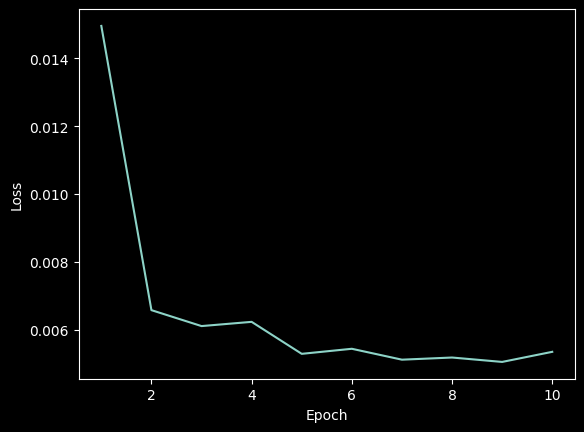

In [37]:
plt.plot(np.arange(1,CFG.EPOCH+1), epoch_losses)
plt.xlabel('Epoch')
plt.ylabel('Loss')

Text(0, 0.5, 'IoU')

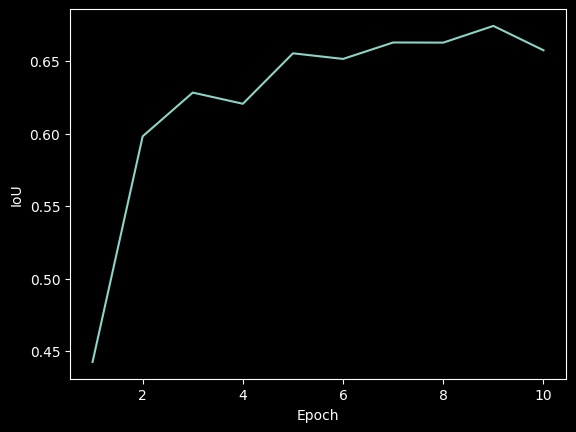

In [38]:
plt.plot(np.arange(1,CFG.EPOCH+1), epoch_ious)
plt.xlabel('Epoch')
plt.ylabel('IoU')

# INFERENCE

## Inference with DataLoader

In [39]:
# create test dataloader
test_sam_ds = SAMDataset(test_dataset, processor=processor)
test_dataloader = DataLoader(test_sam_ds, batch_size=CFG.TEST_BATCH_SIZE, shuffle=False)

  0%|          | 0/136 [00:00<?, ?it/s]

IoU: tensor([[0.]])


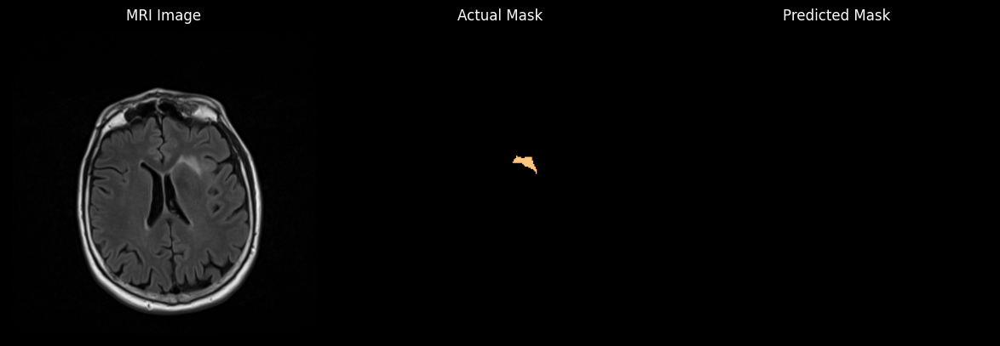

IoU: tensor([[0.8402]])


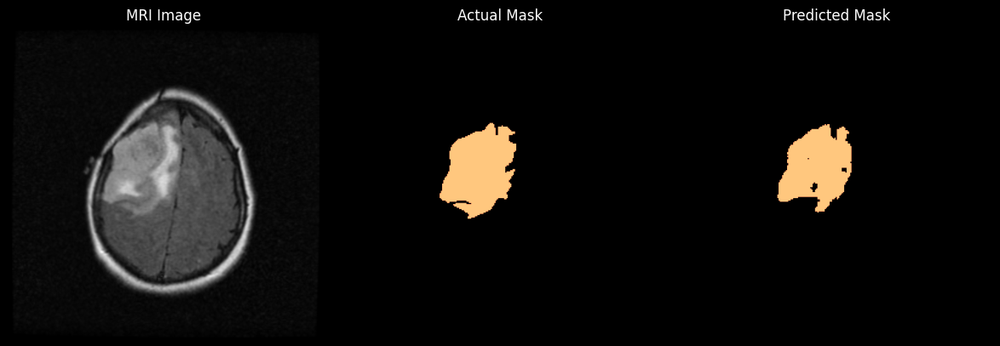

IoU: tensor([[0.8098]])


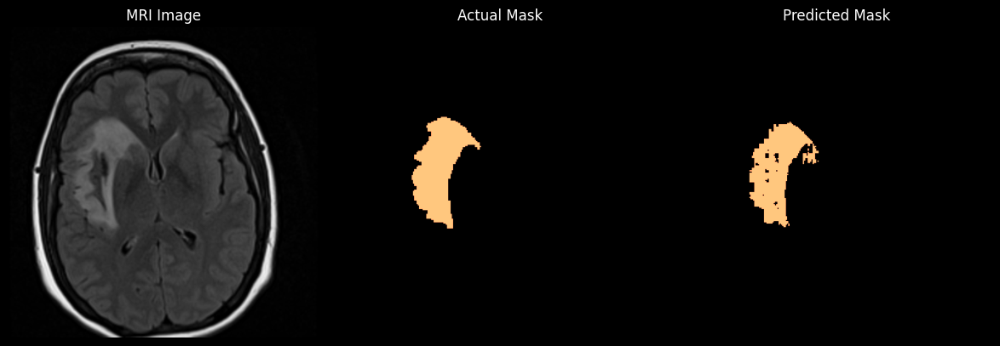

IoU: tensor([[0.2538]])


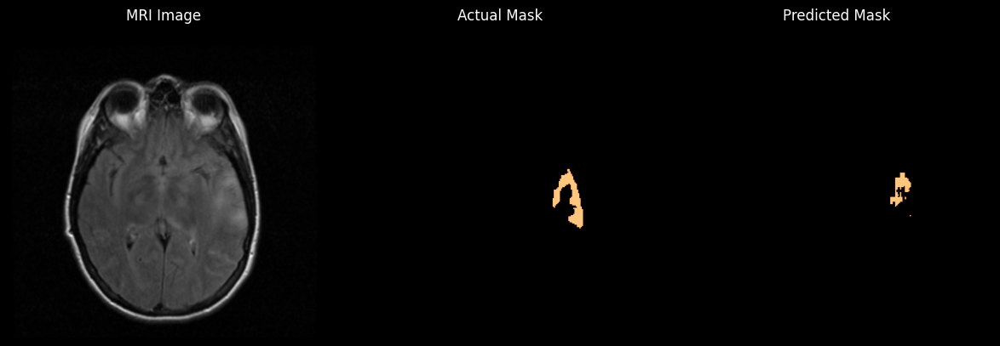

IoU: tensor([[0.9119]])


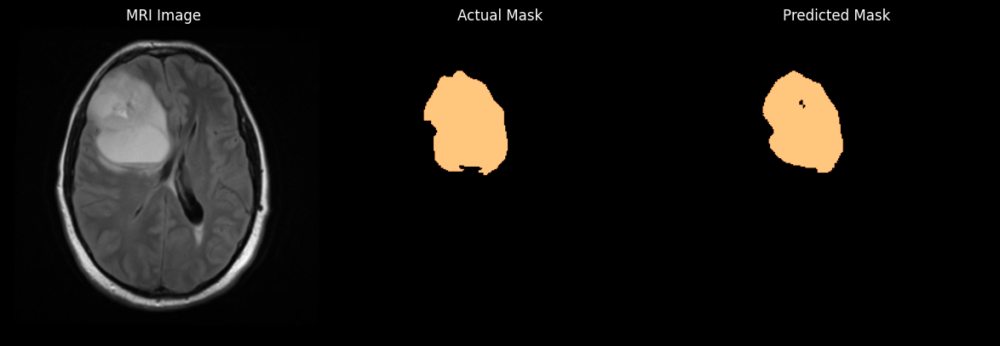

IoU: tensor([[0.9210]])


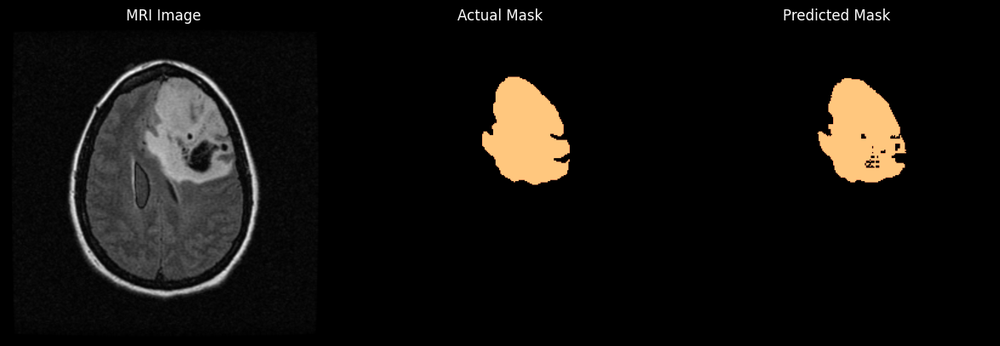

IoU: tensor([[0.6061]])


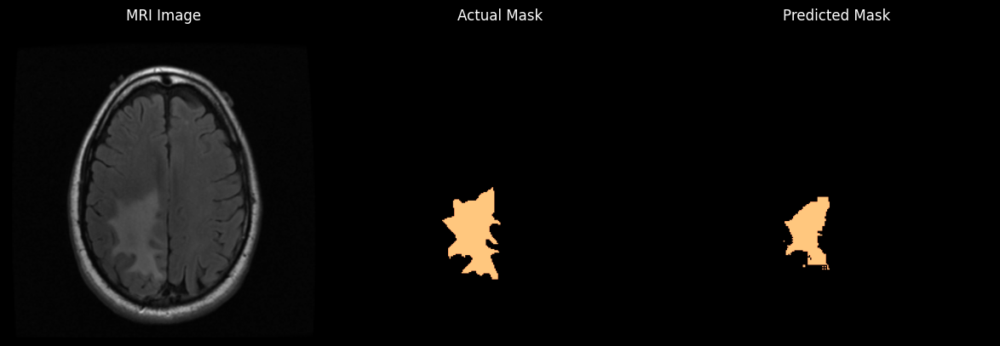

IoU: tensor([[0.7574]])


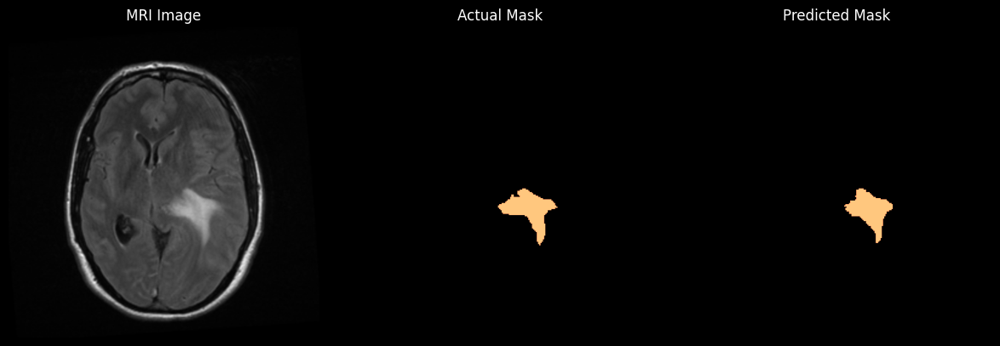

IoU: tensor([[0.2248]])


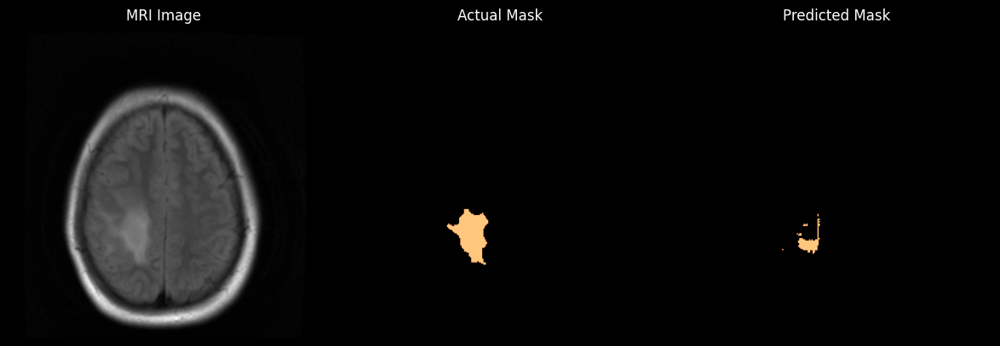

IoU: tensor([[0.9339]])


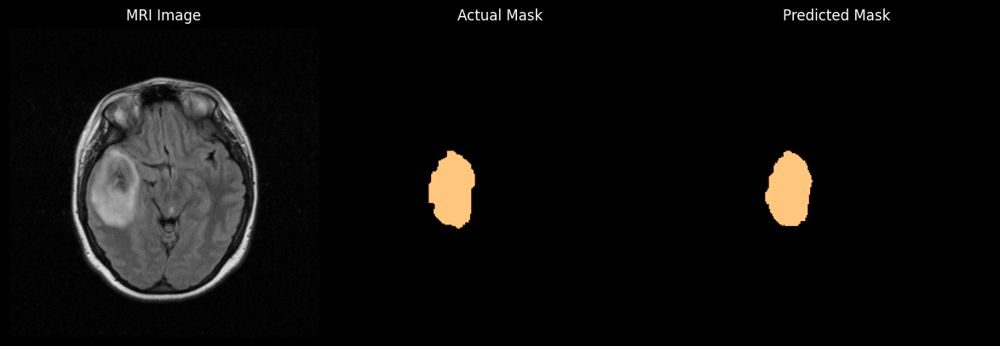

IoU: tensor([[0.8854]])


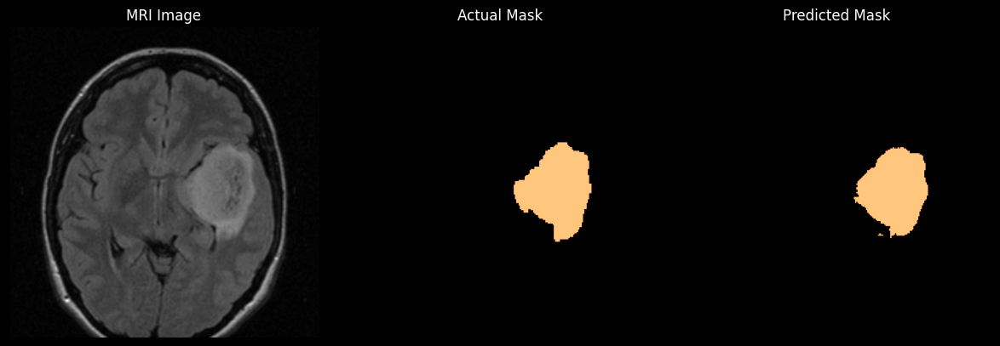

IoU: tensor([[0.7336]])


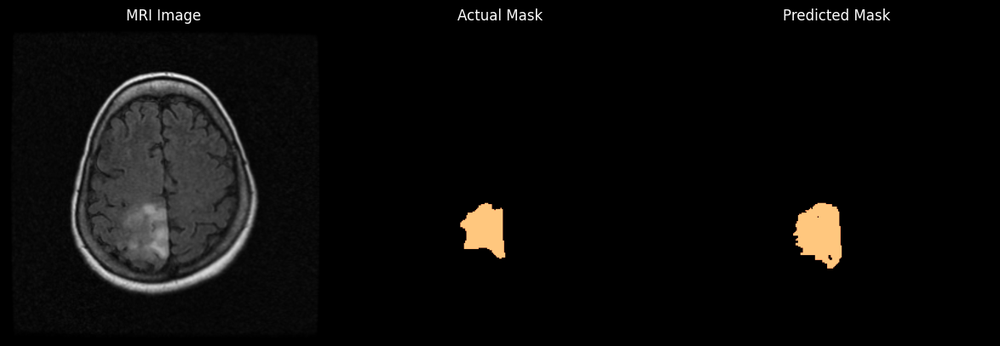

IoU: tensor([[0.8275]])


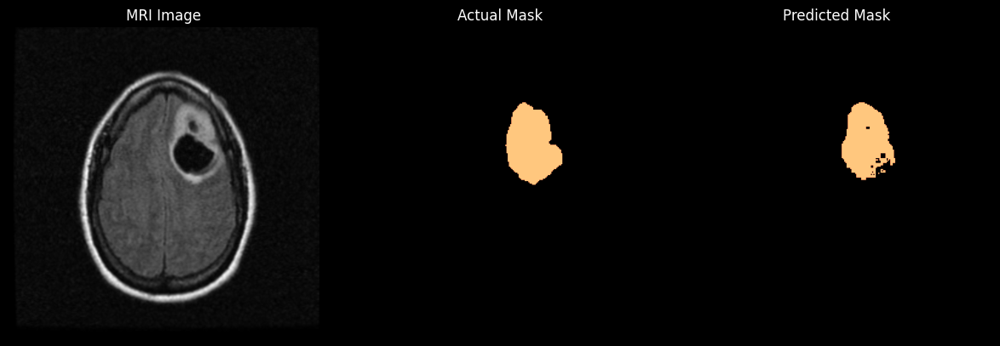

IoU: tensor([[0.5843]])


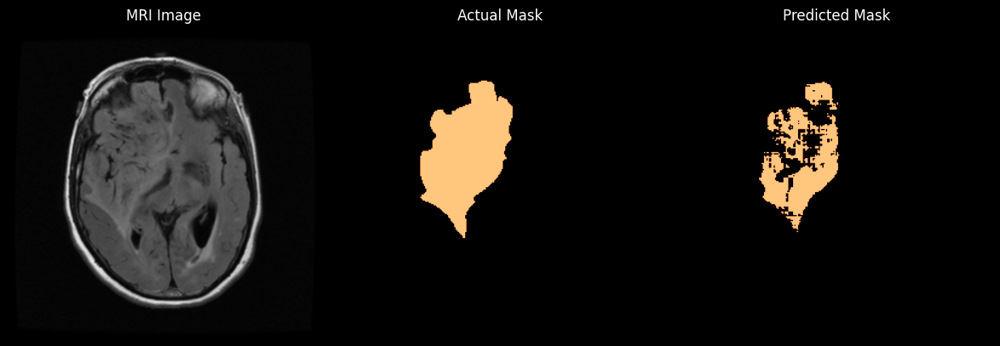

IoU: tensor([[0.4047]])


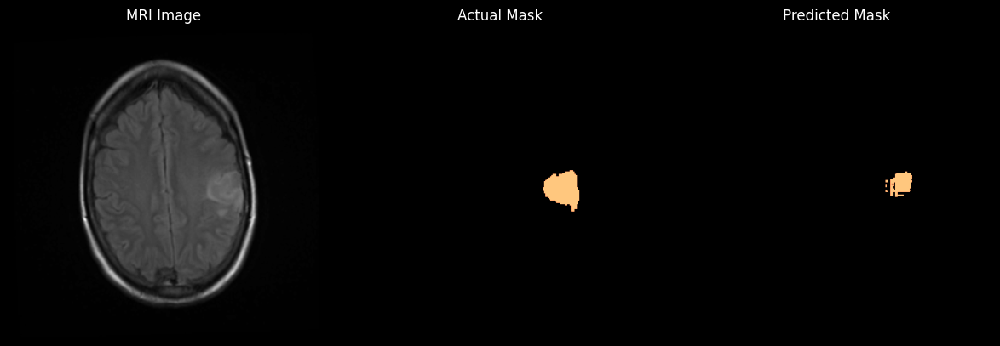

IoU: tensor([[0.7072]])


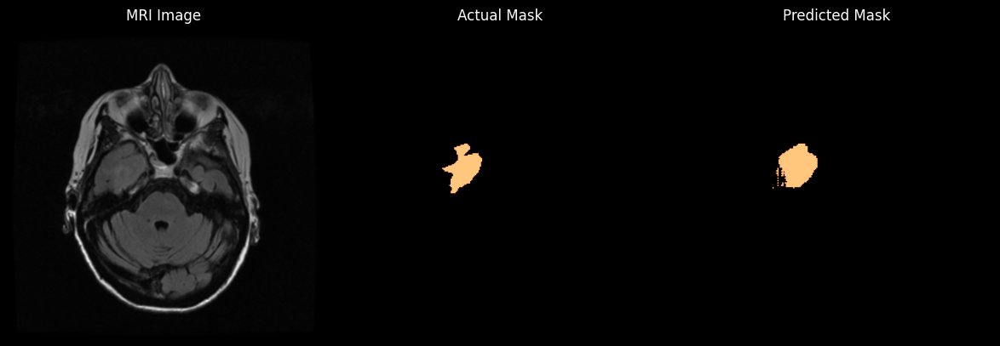

IoU: tensor([[0.]])


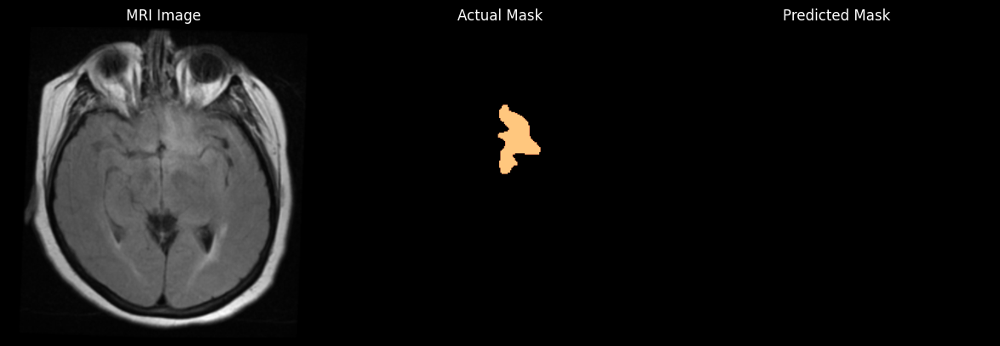

IoU: tensor([[0.8523]])


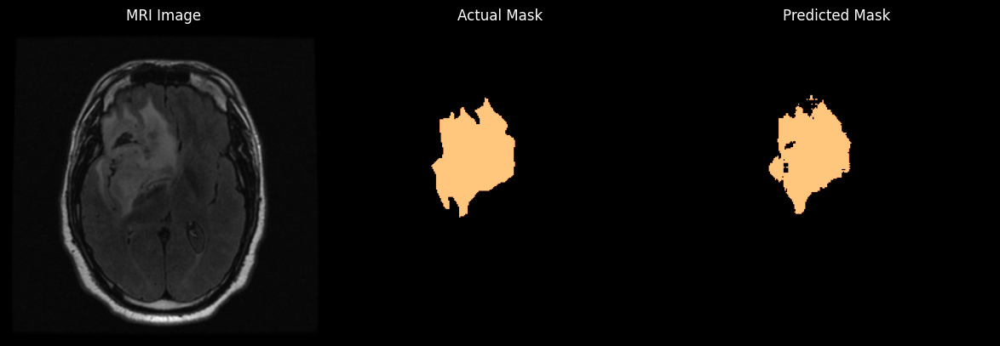

IoU: tensor([[0.0138]])


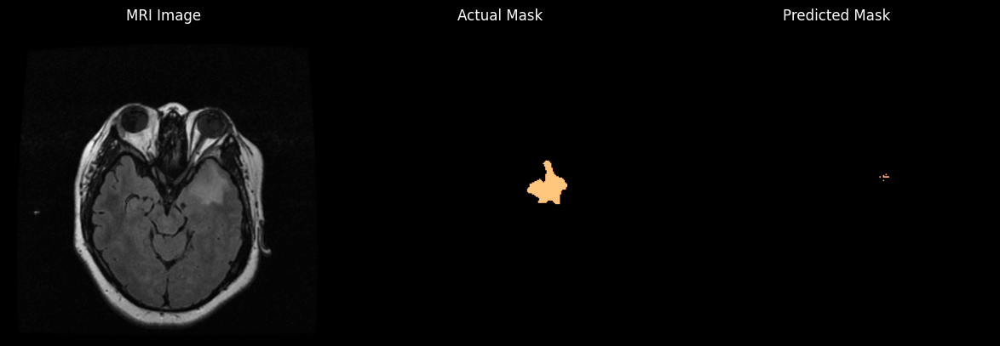

IoU: tensor([[0.8041]])


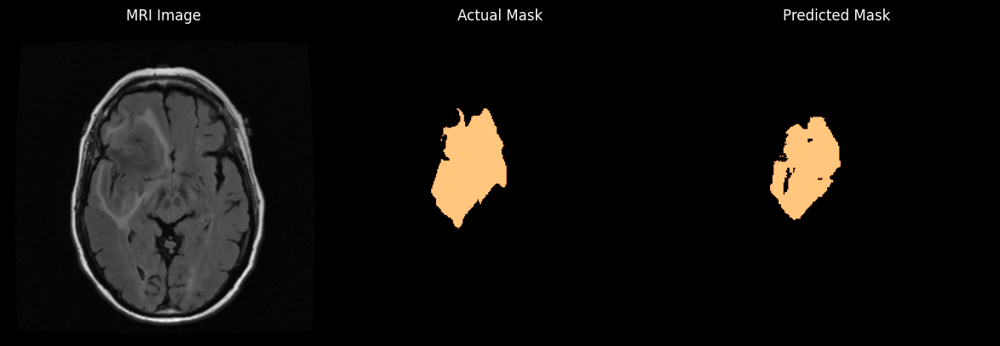

IoU: tensor([[0.]])


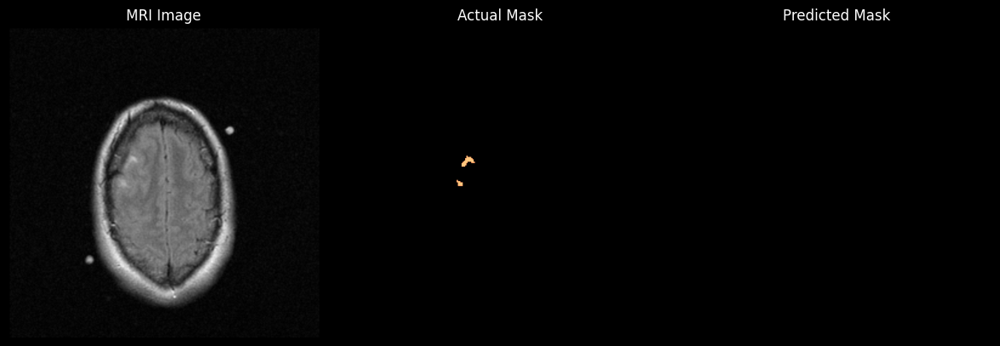

IoU: tensor([[0.7038]])


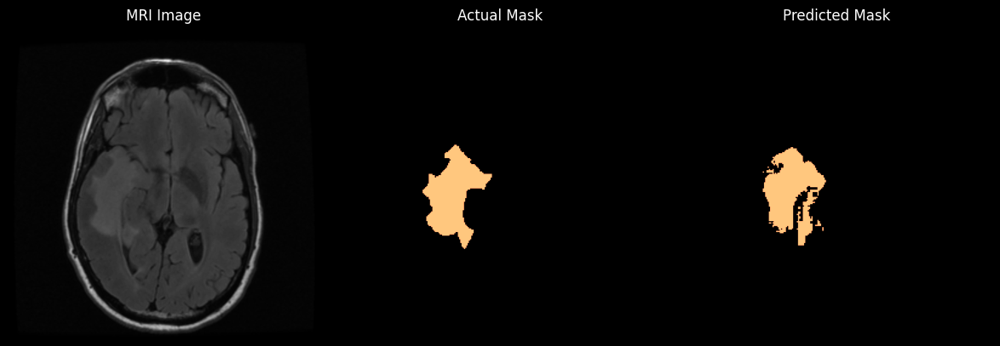

IoU: tensor([[0.6925]])


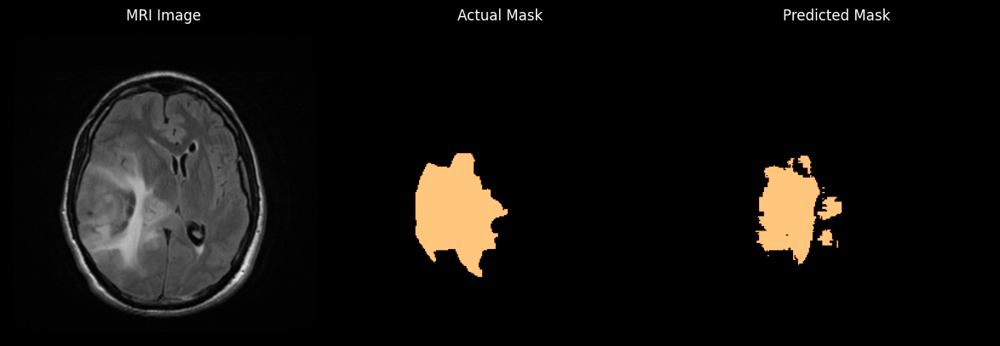

IoU: tensor([[0.4566]])


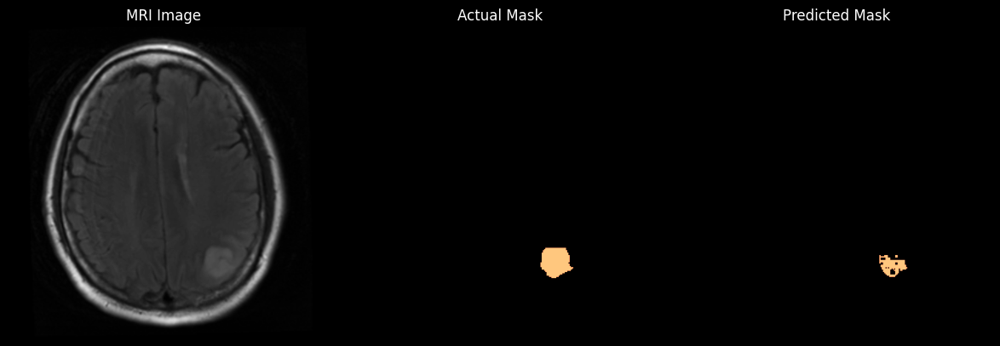

IoU: tensor([[0.9174]])


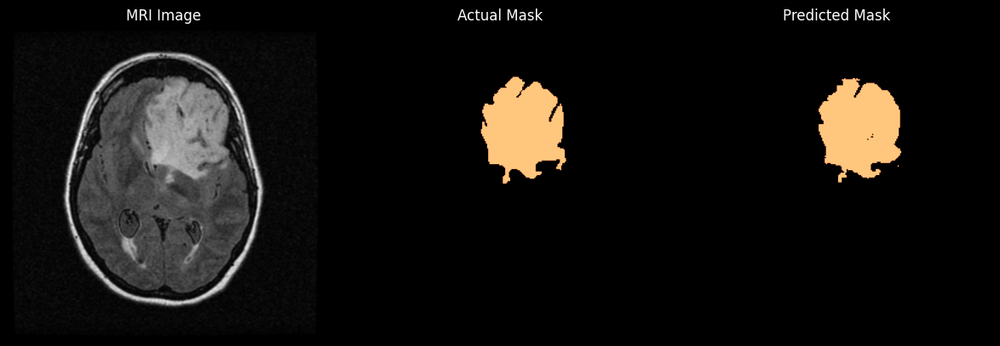

IoU: tensor([[0.4924]])


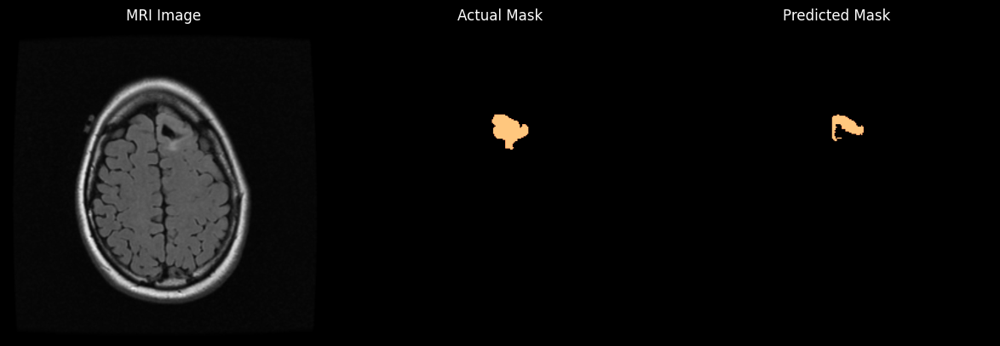

IoU: tensor([[0.5090]])


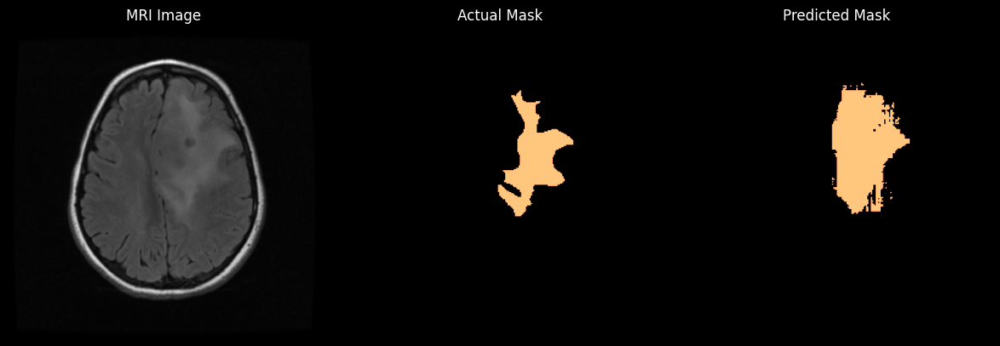

IoU: tensor([[0.]])


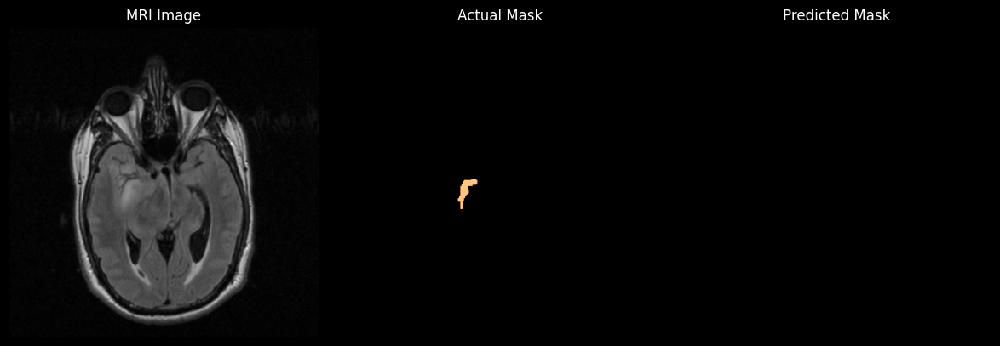

IoU: tensor([[0.8731]])


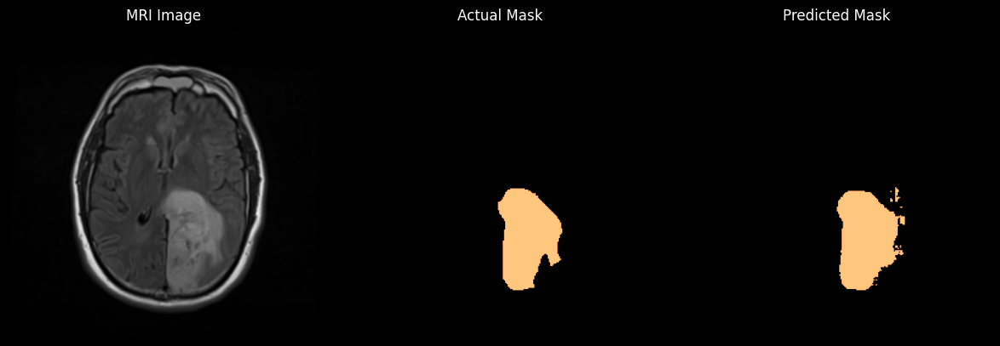

IoU: tensor([[0.7497]])


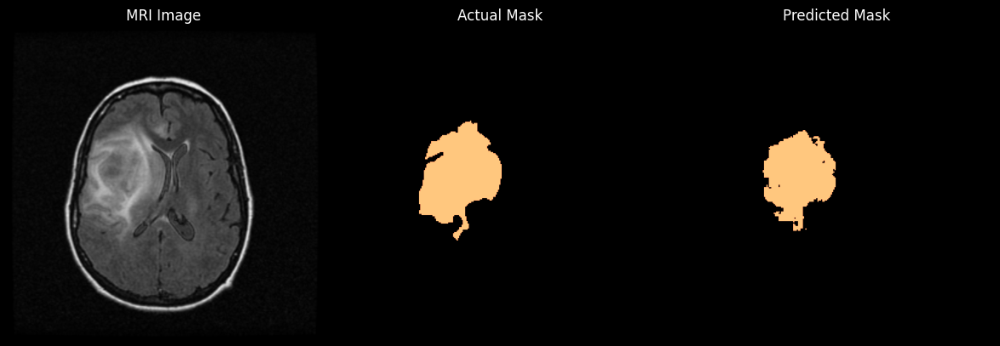

IoU: tensor([[0.]])


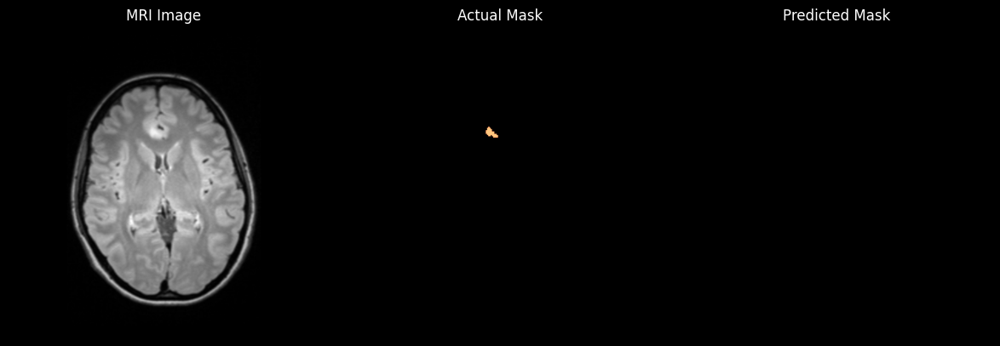

IoU: tensor([[0.]])


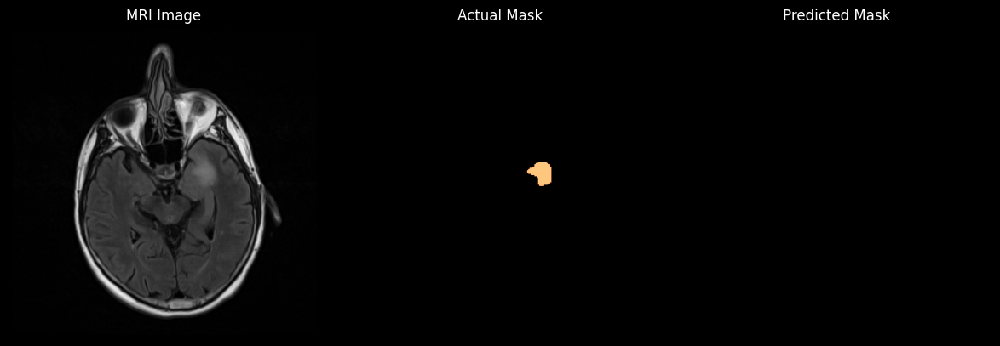

IoU: tensor([[0.6566]])


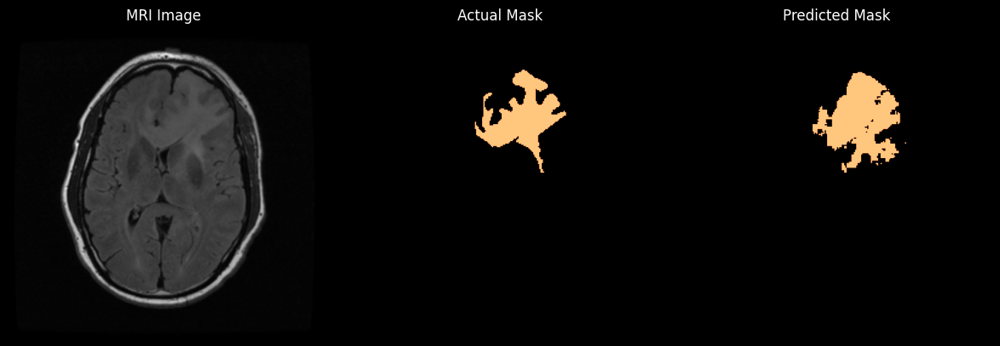

IoU: tensor([[0.7564]])


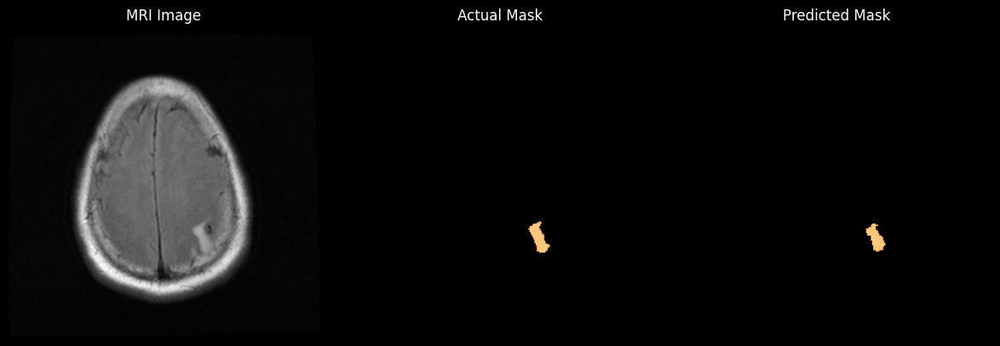

IoU: tensor([[0.9290]])


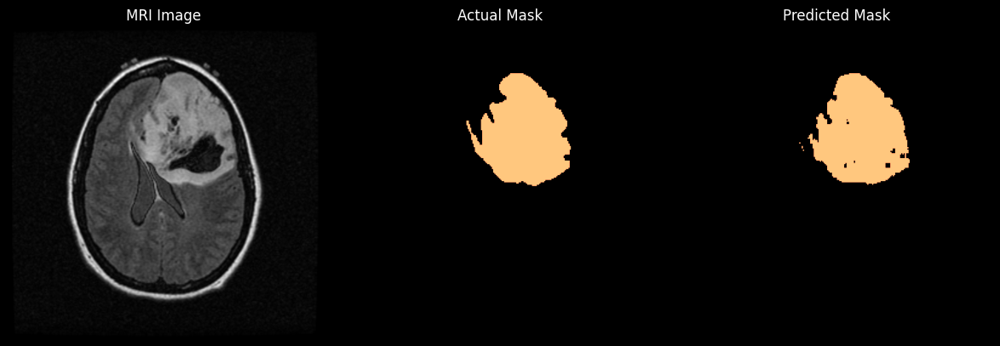

IoU: tensor([[0.5795]])


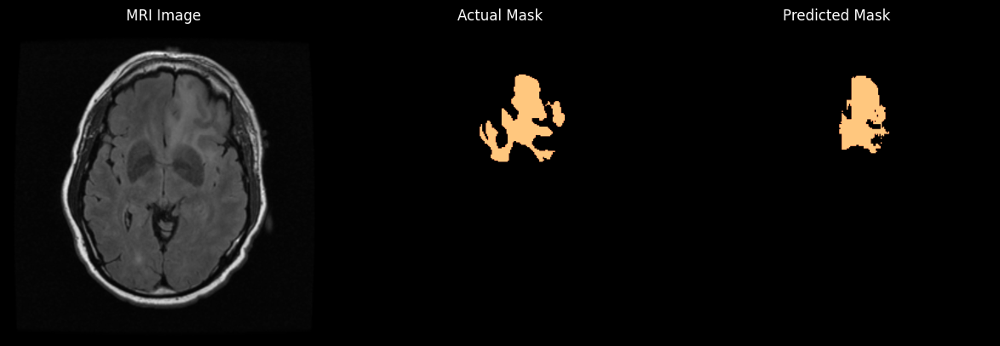

IoU: tensor([[0.8130]])


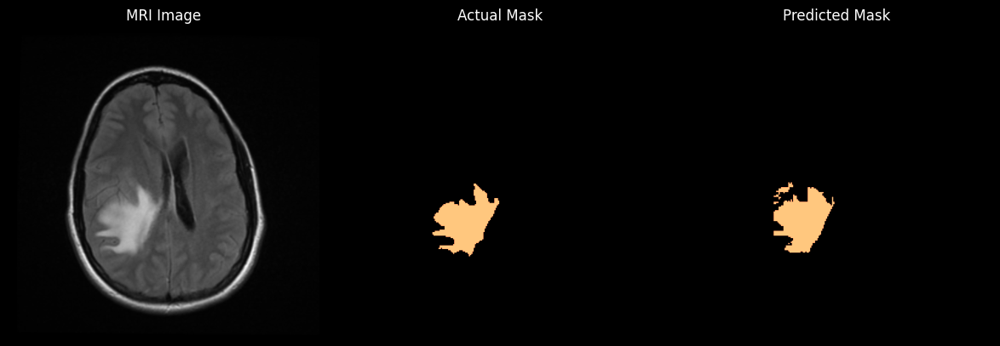

IoU: tensor([[0.9041]])


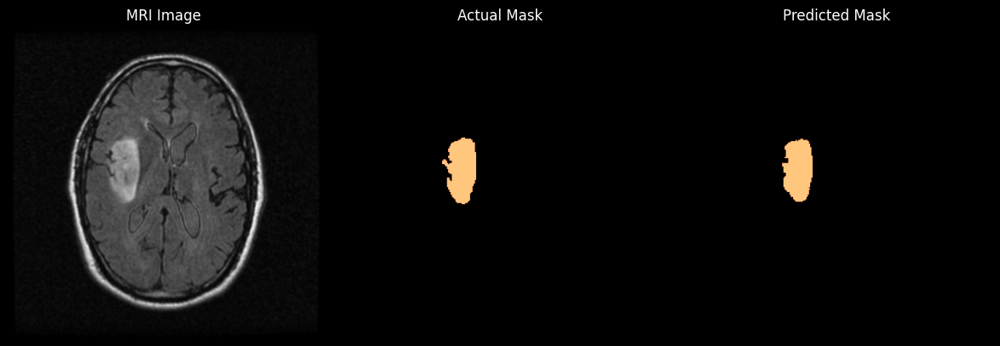

IoU: tensor([[0.8978]])


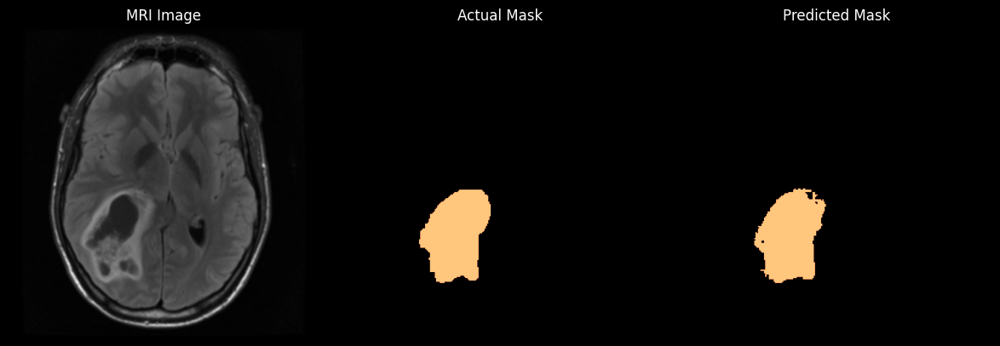

IoU: tensor([[0.9106]])


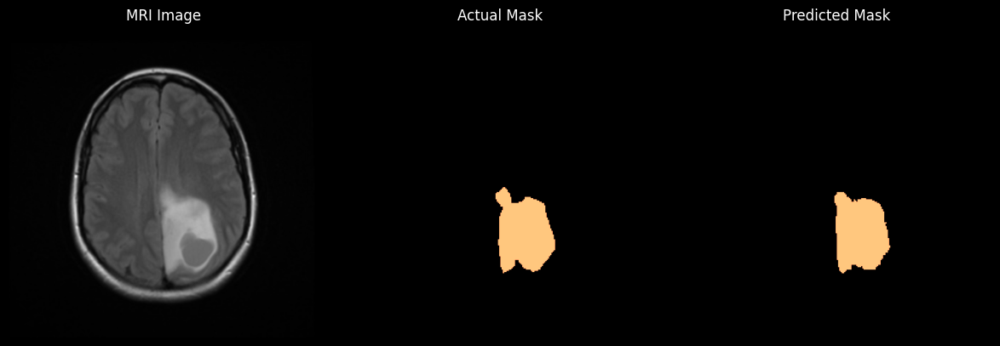

IoU: tensor([[0.7253]])


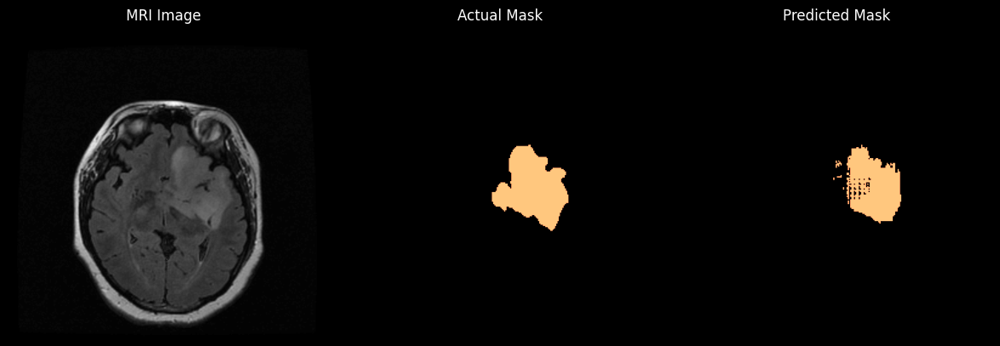

IoU: tensor([[0.5331]])


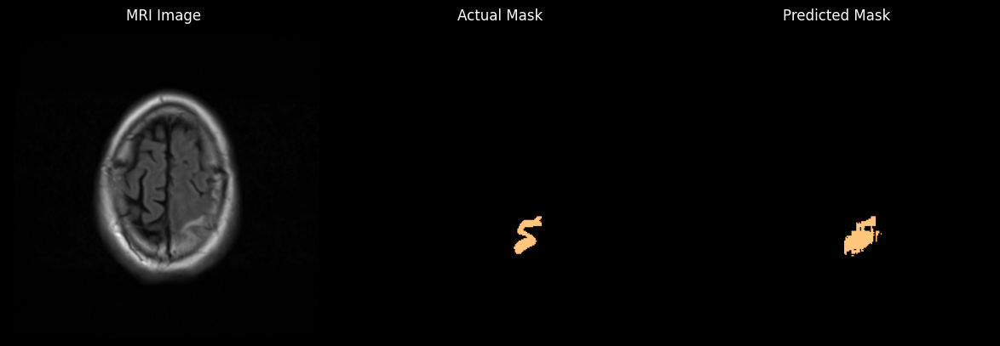

IoU: tensor([[0.7596]])


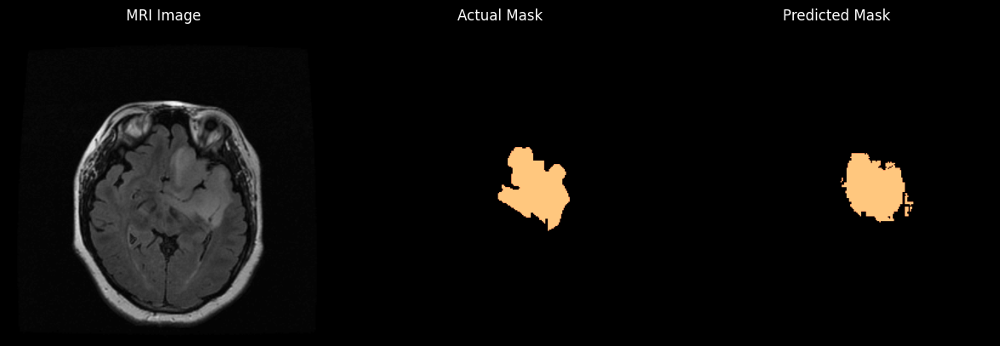

IoU: tensor([[0.0382]])


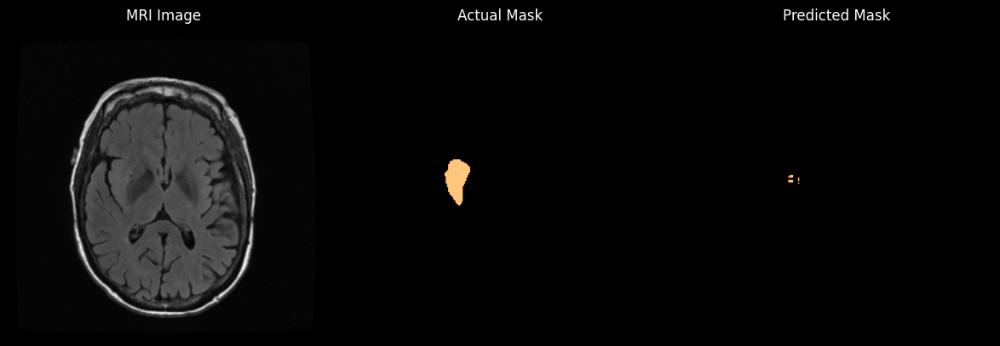

IoU: tensor([[0.7376]])


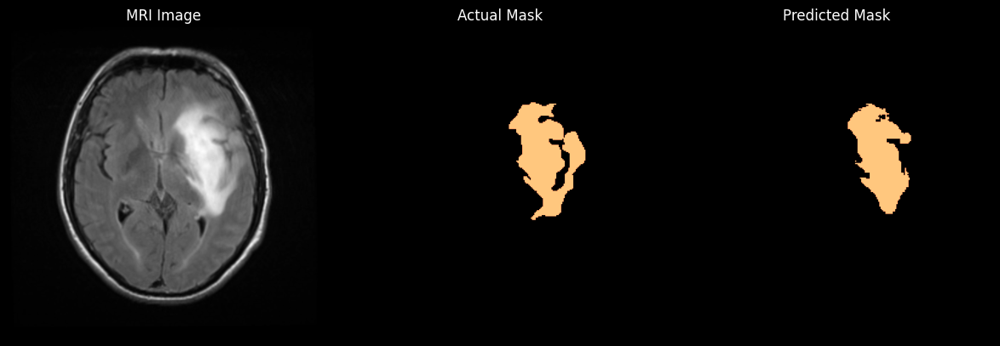

IoU: tensor([[0.7676]])


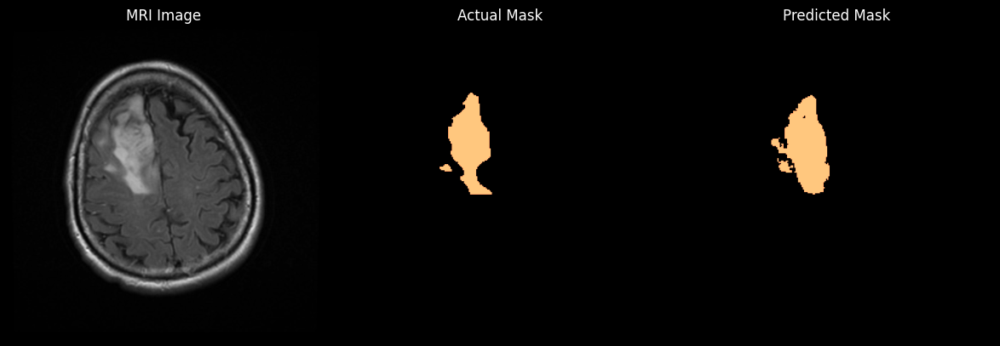

IoU: tensor([[0.6305]])


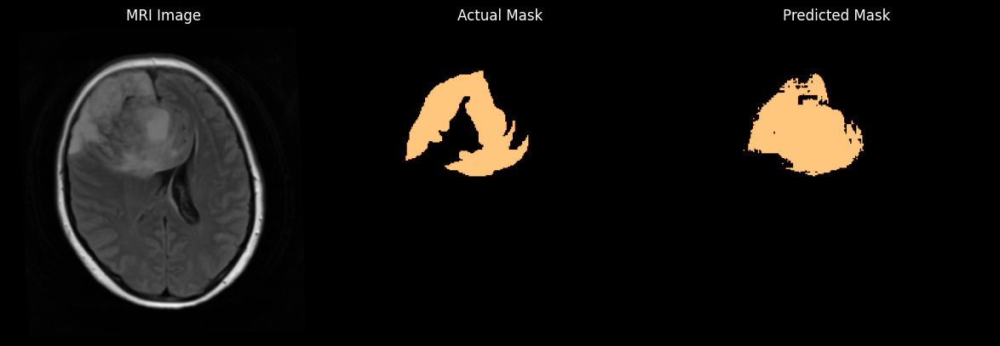

IoU: tensor([[0.2256]])


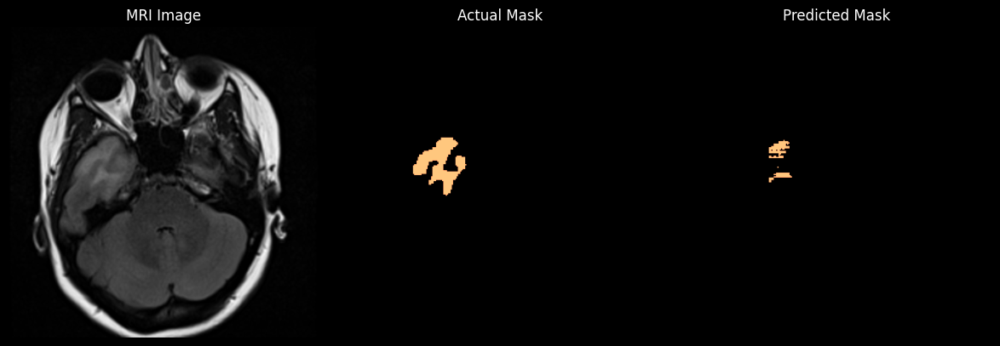

IoU: tensor([[0.]])


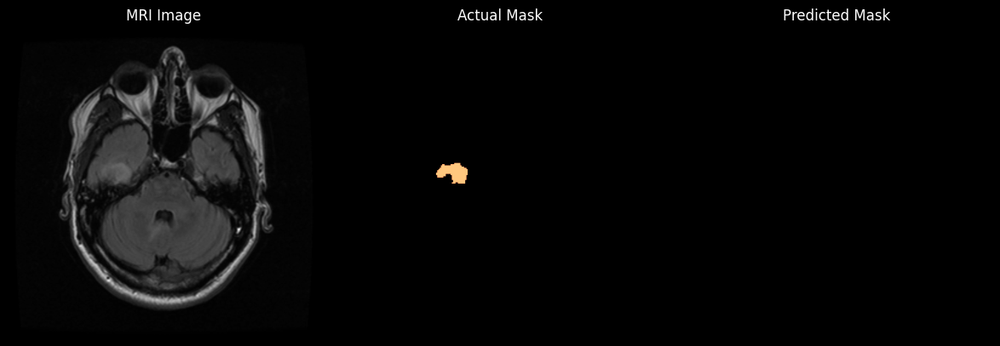

IoU: tensor([[0.]])


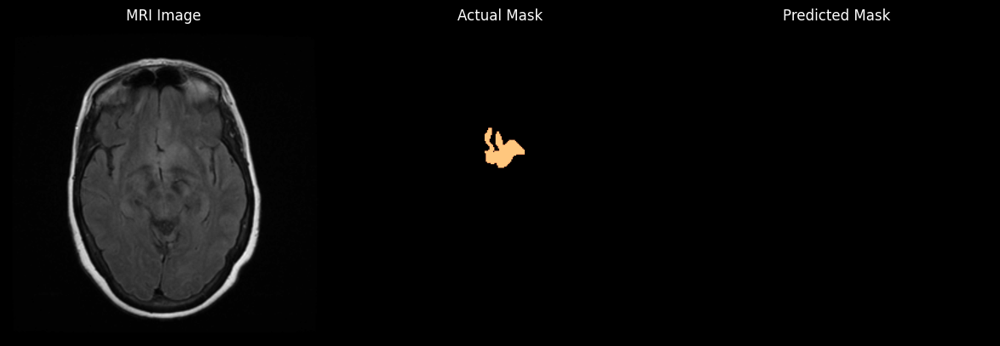

IoU: tensor([[0.0746]])


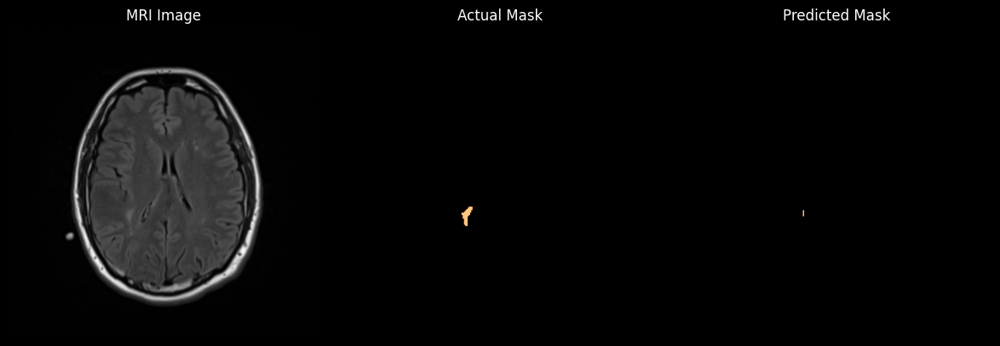

IoU: tensor([[0.7264]])


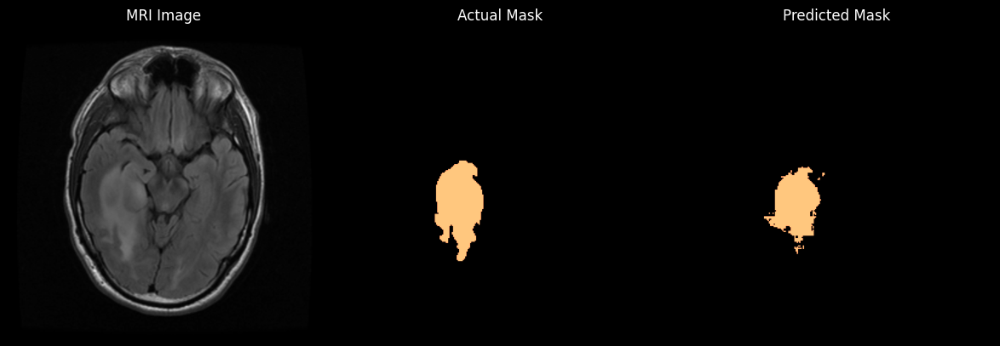

IoU: tensor([[0.9054]])


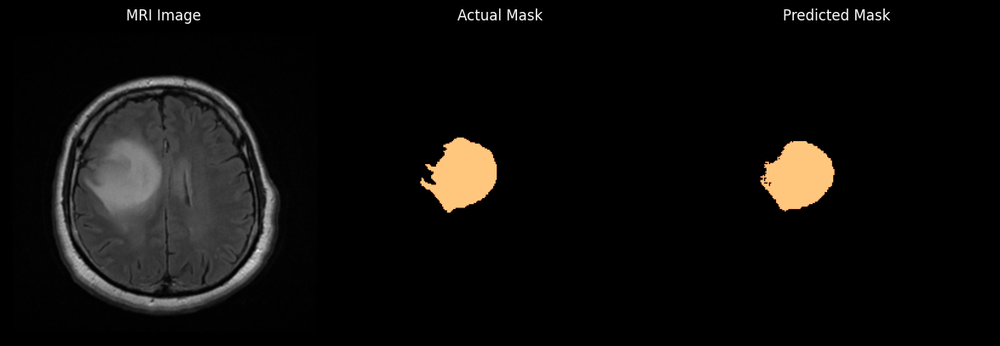

IoU: tensor([[0.3363]])


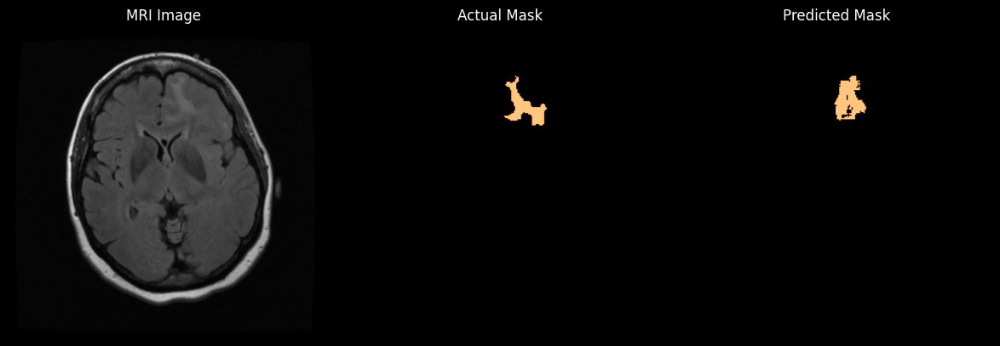

IoU: tensor([[0.1787]])


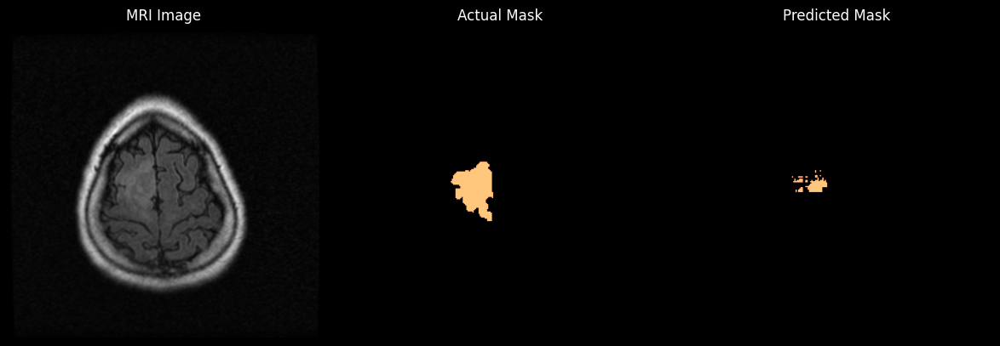

IoU: tensor([[0.8724]])


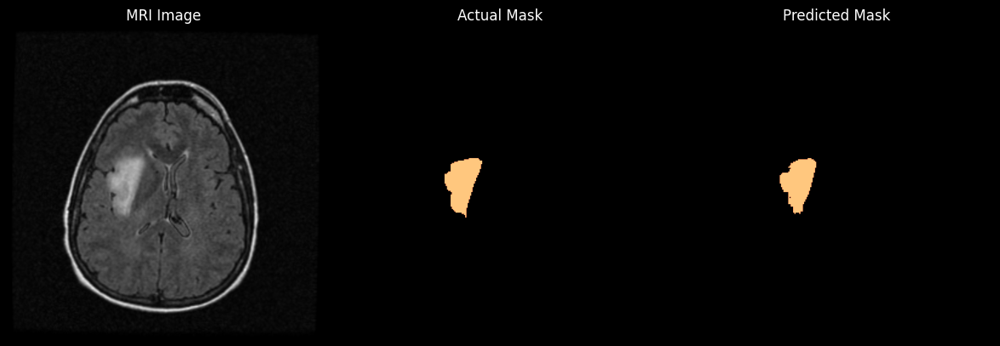

IoU: tensor([[0.4610]])


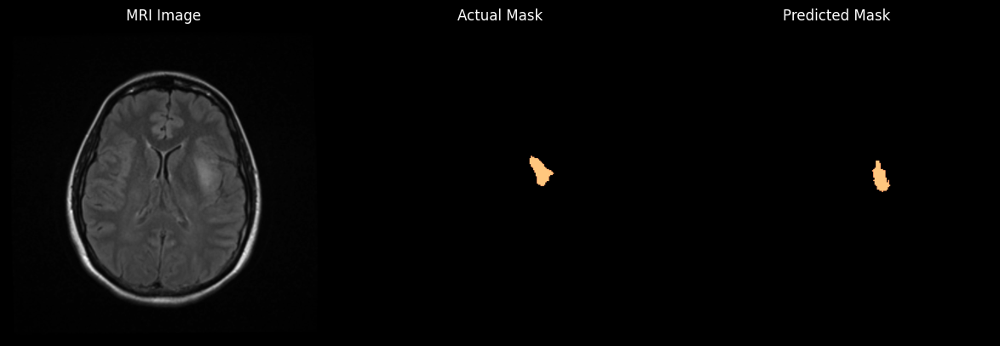

IoU: tensor([[0.2891]])


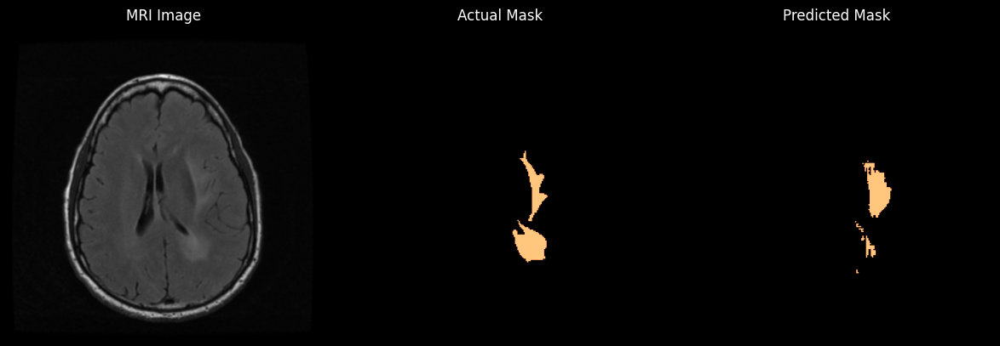

IoU: tensor([[0.8602]])


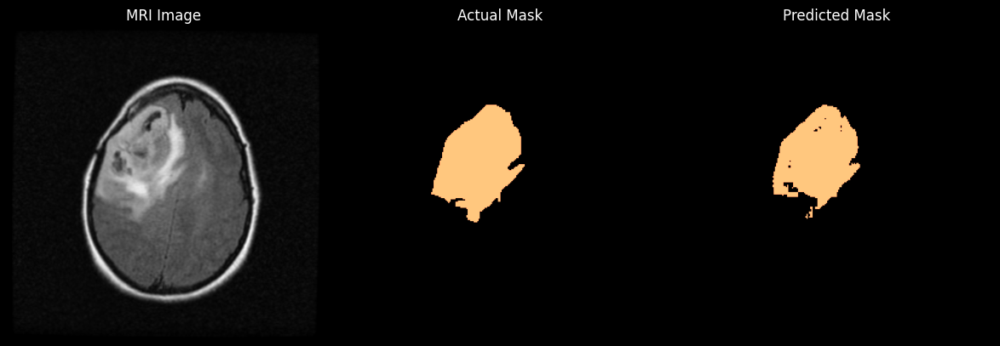

IoU: tensor([[0.4074]])


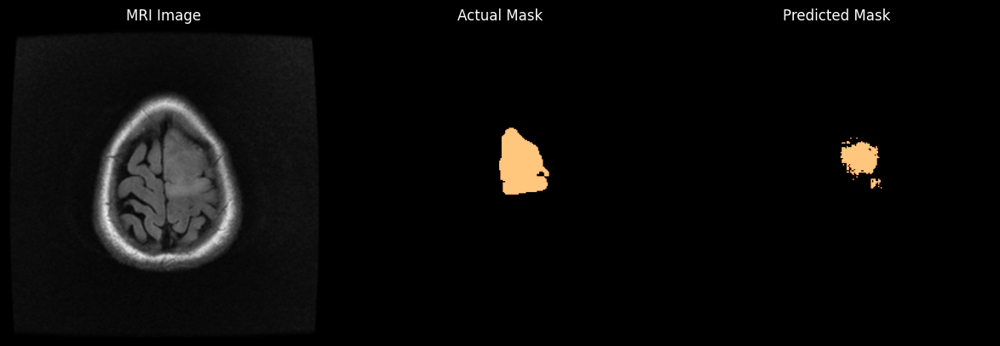

IoU: tensor([[0.0823]])


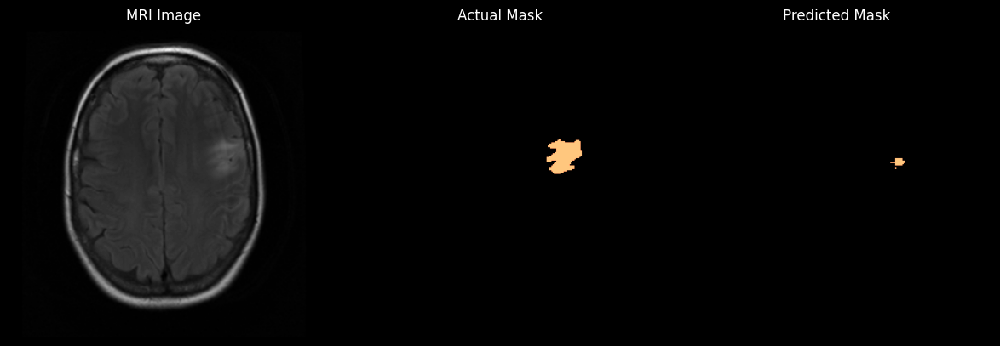

IoU: tensor([[0.6769]])


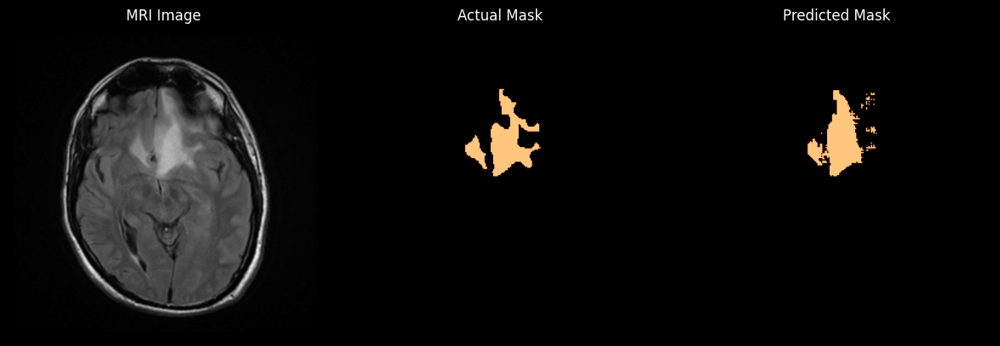

IoU: tensor([[0.5917]])


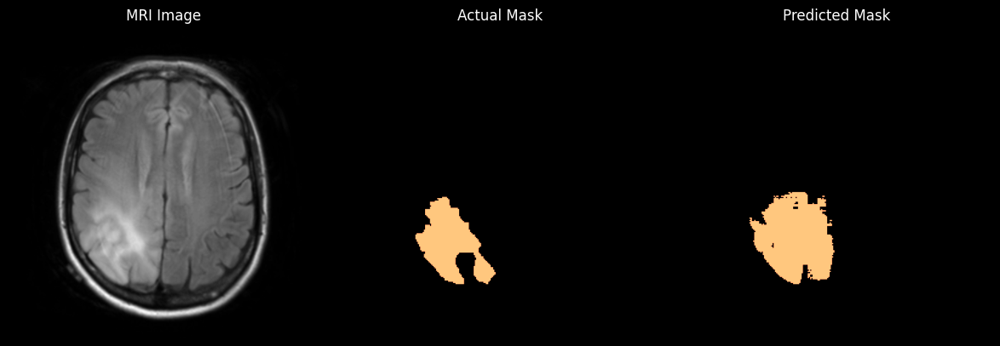

IoU: tensor([[0.5442]])


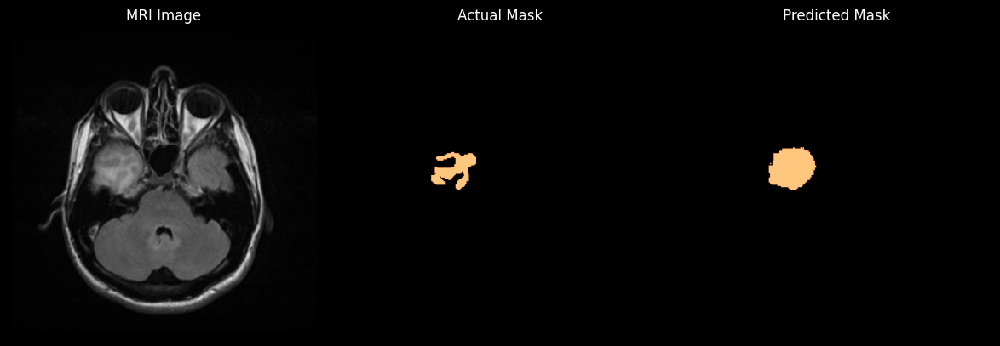

IoU: tensor([[0.]])


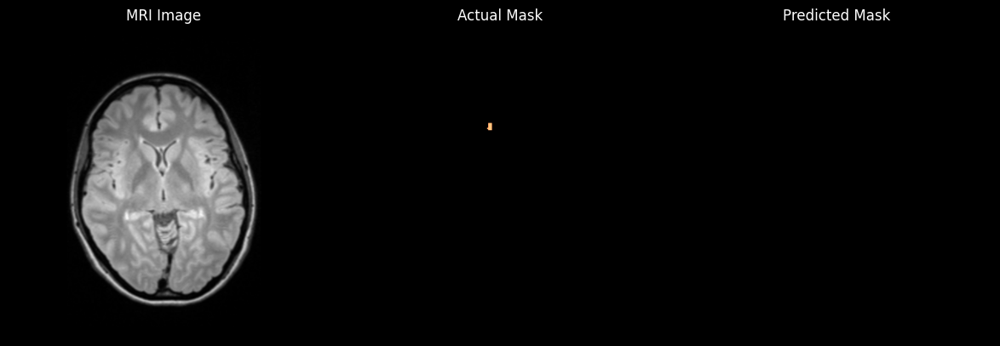

IoU: tensor([[0.4054]])


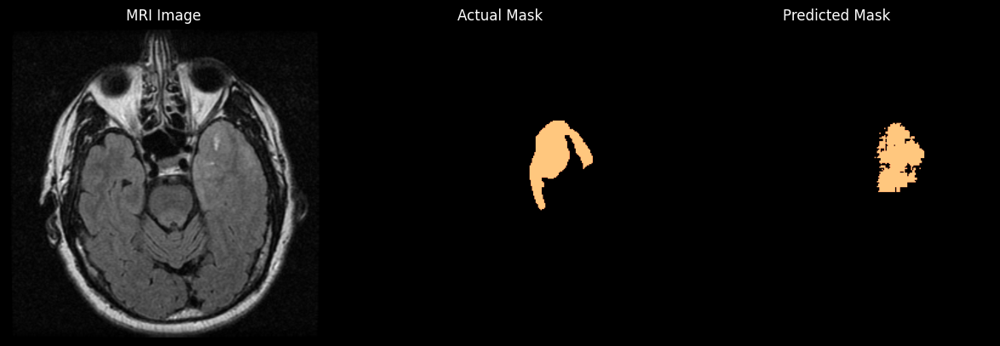

IoU: tensor([[0.1940]])


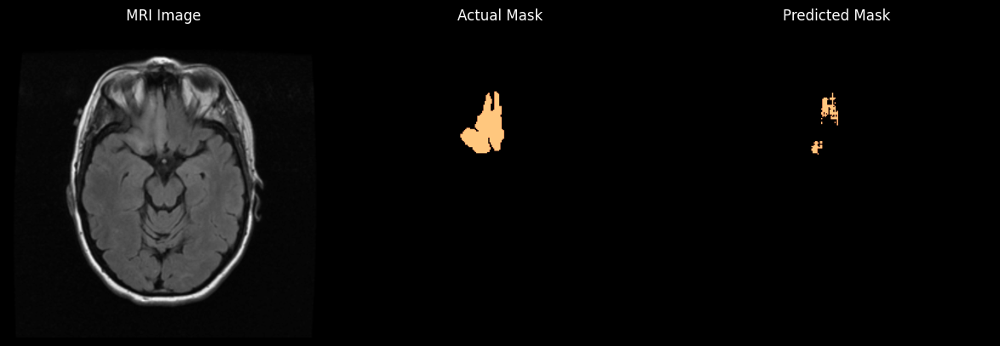

IoU: tensor([[0.6468]])


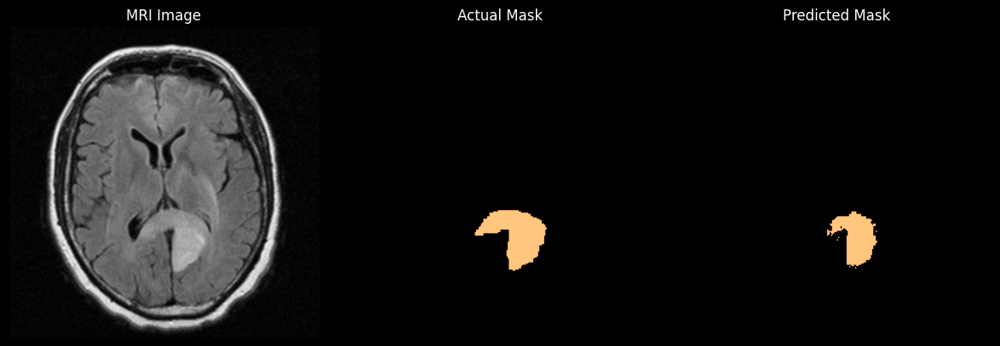

IoU: tensor([[0.8775]])


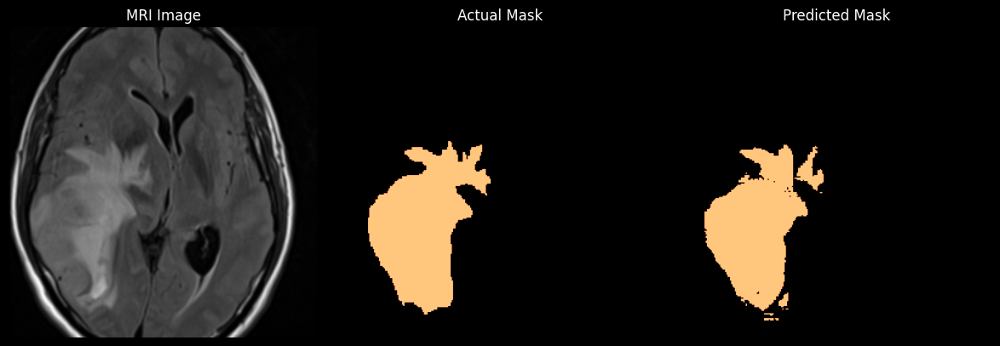

IoU: tensor([[0.7317]])


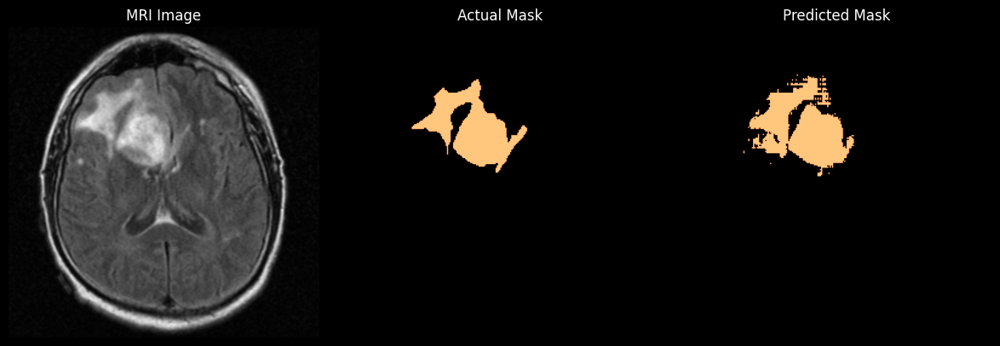

IoU: tensor([[0.8866]])


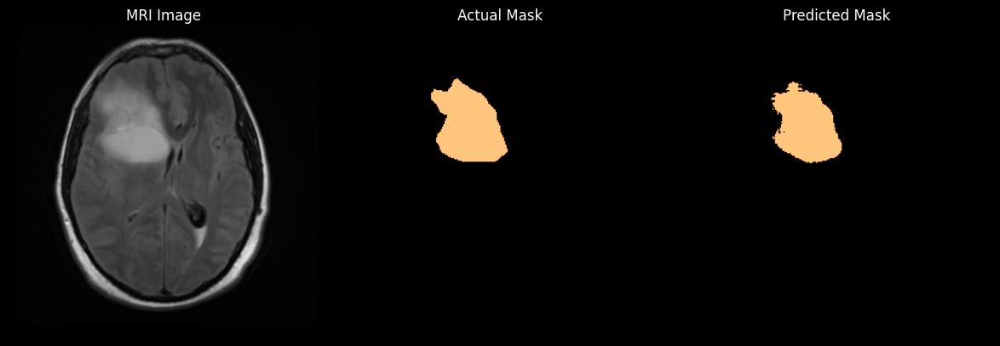

IoU: tensor([[0.5575]])


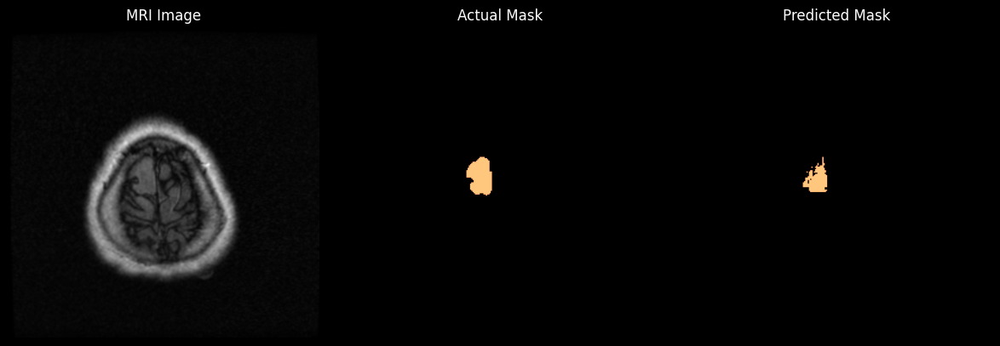

IoU: tensor([[0.5700]])


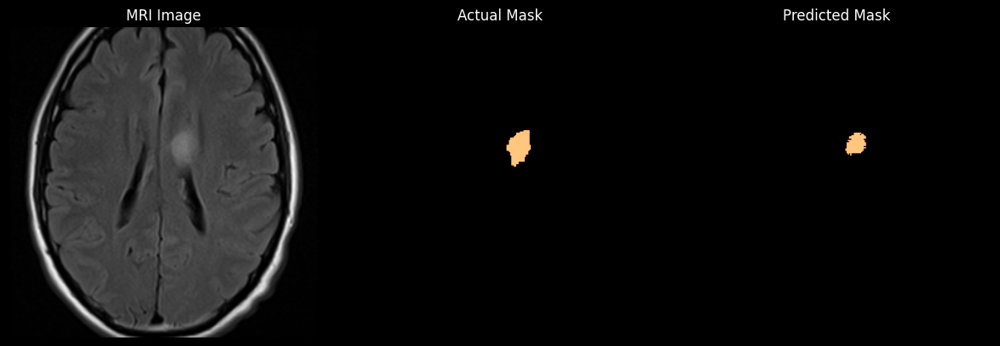

IoU: tensor([[0.7726]])


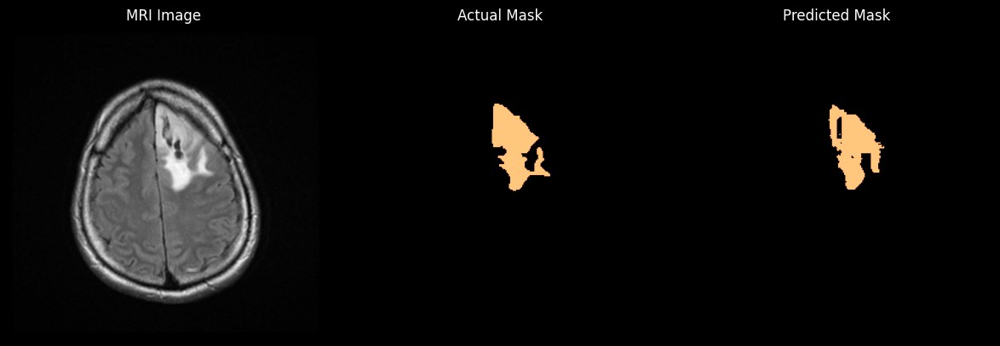

IoU: tensor([[0.7304]])


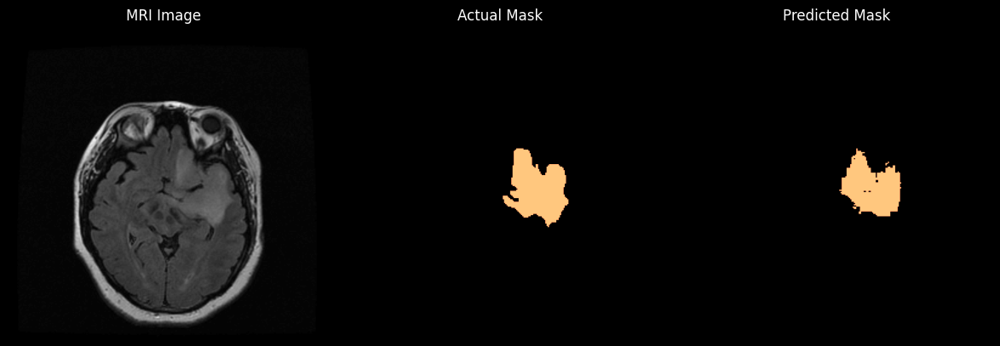

IoU: tensor([[0.8142]])


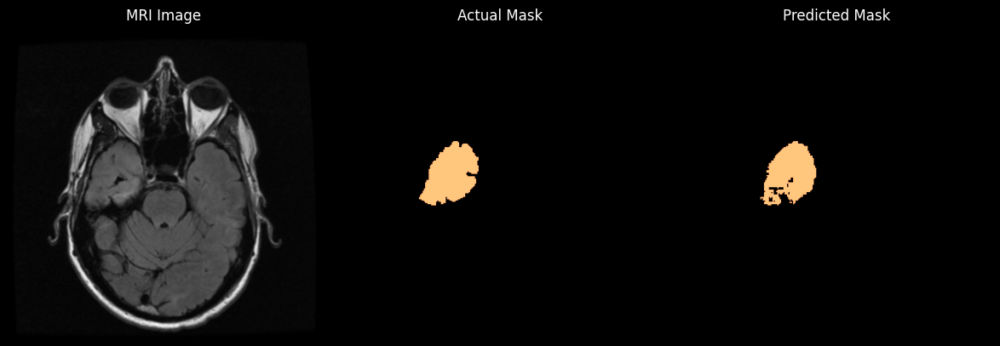

IoU: tensor([[0.2910]])


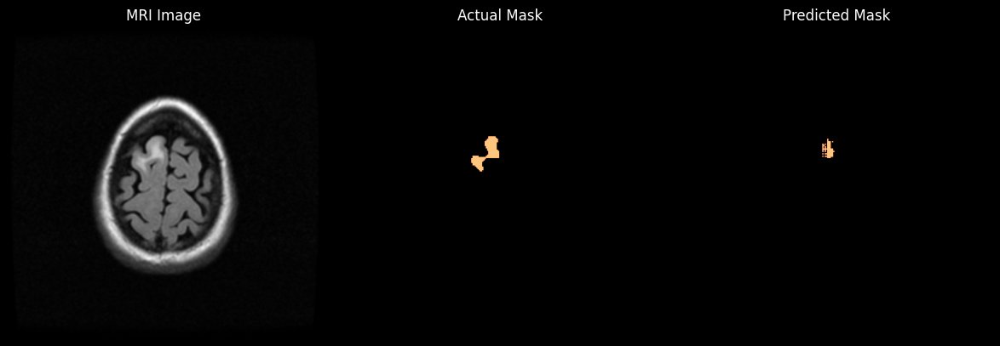

IoU: tensor([[0.3456]])


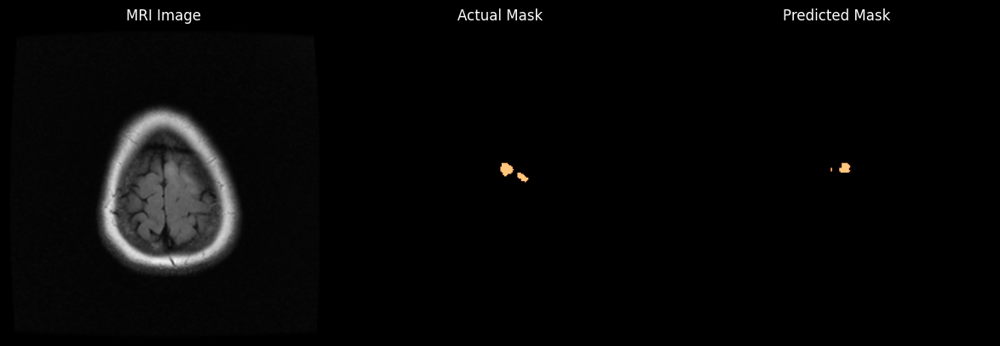

IoU: tensor([[0.7218]])


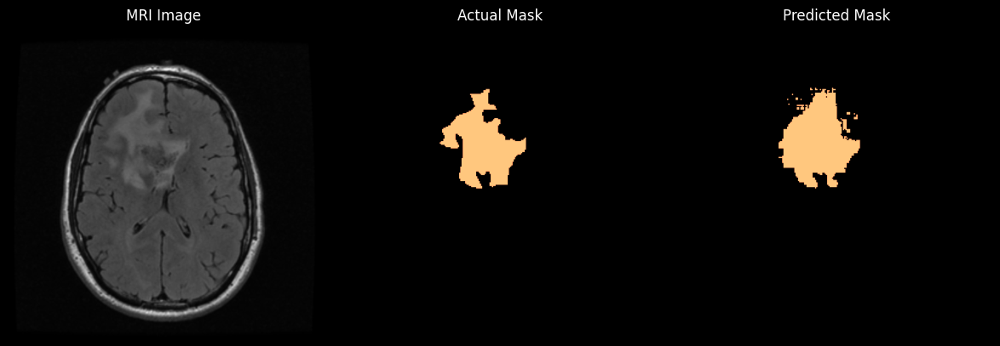

IoU: tensor([[0.3399]])


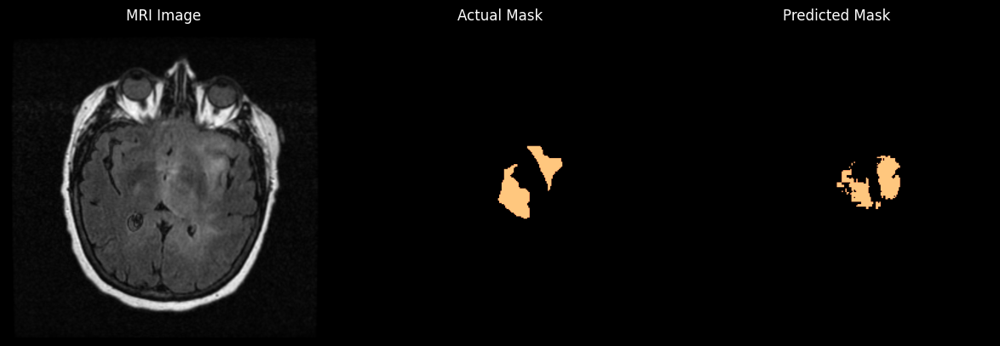

IoU: tensor([[0.5612]])


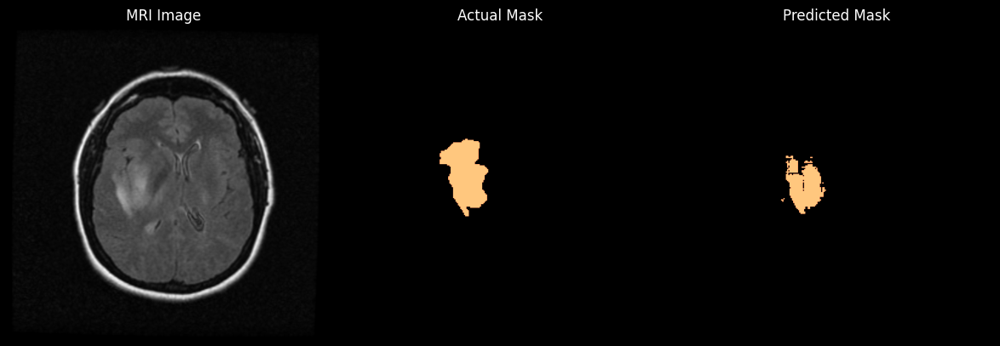

IoU: tensor([[0.7569]])


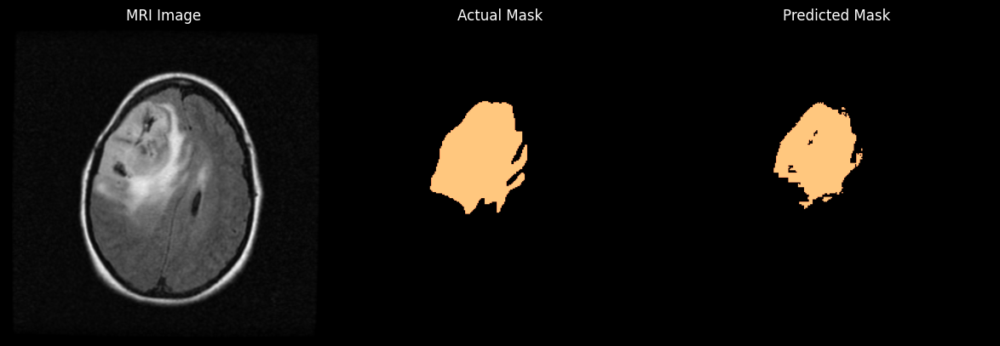

IoU: tensor([[0.8977]])


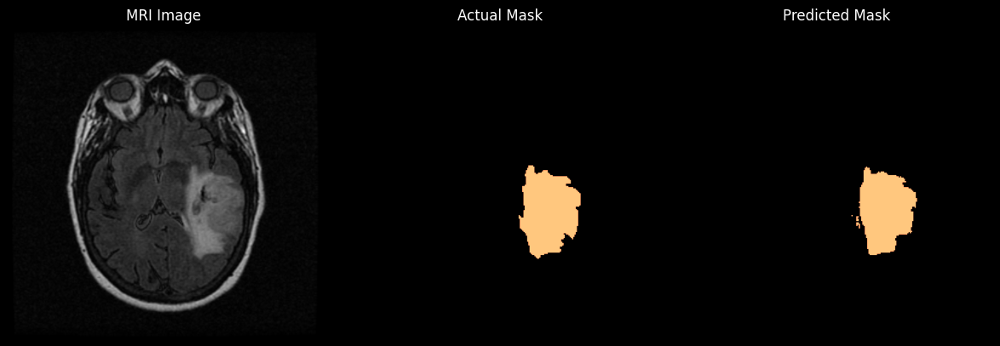

IoU: tensor([[0.0228]])


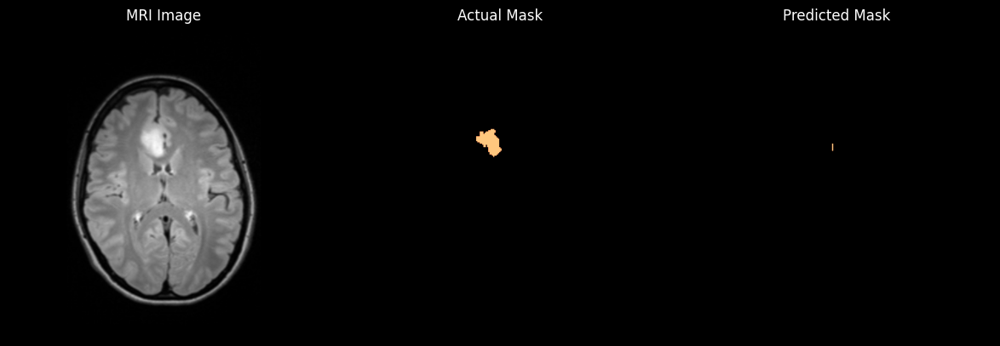

IoU: tensor([[0.9434]])


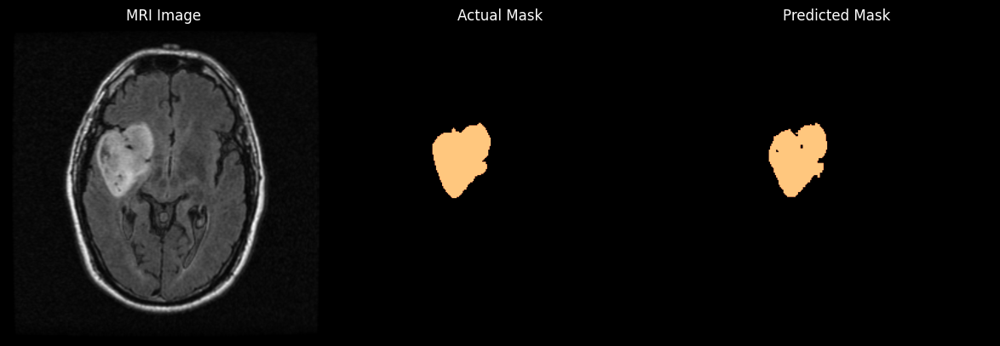

IoU: tensor([[0.8949]])


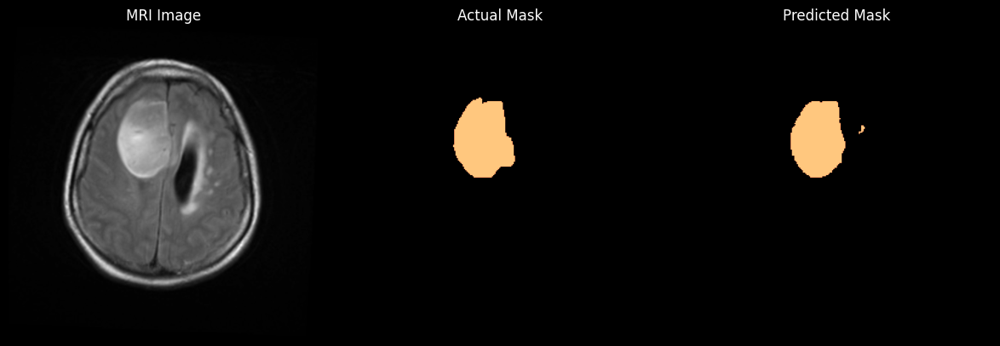

IoU: tensor([[0.8710]])


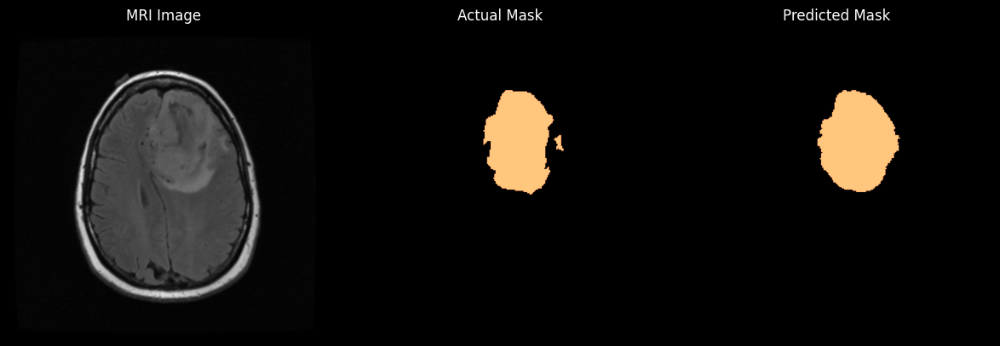

IoU: tensor([[0.8662]])


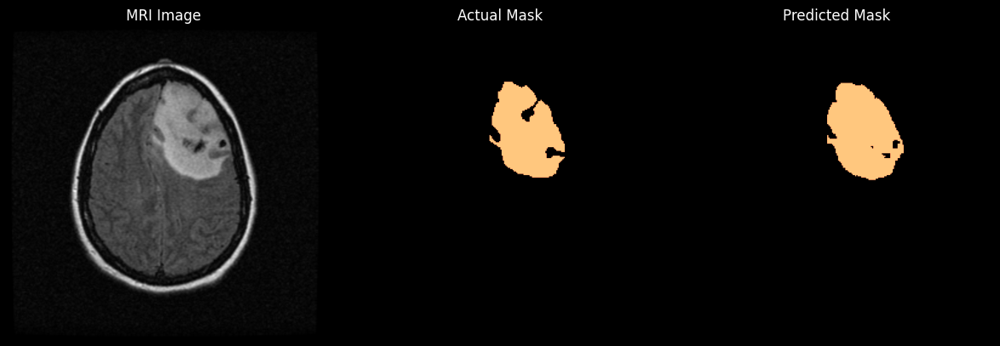

IoU: tensor([[0.6458]])


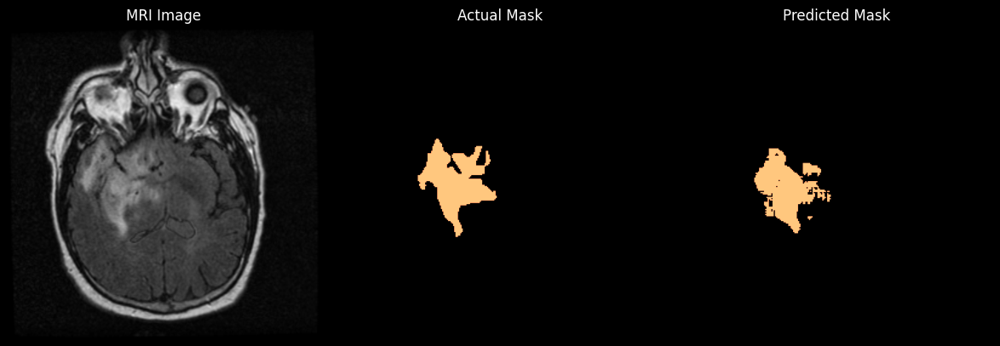

IoU: tensor([[0.6484]])


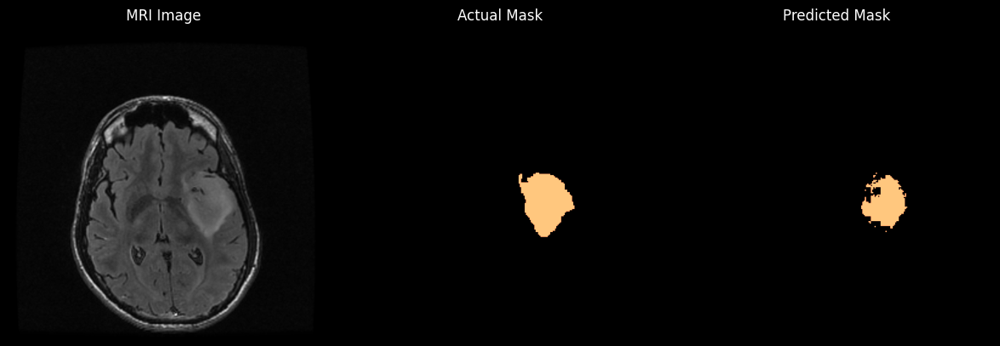

IoU: tensor([[0.6304]])


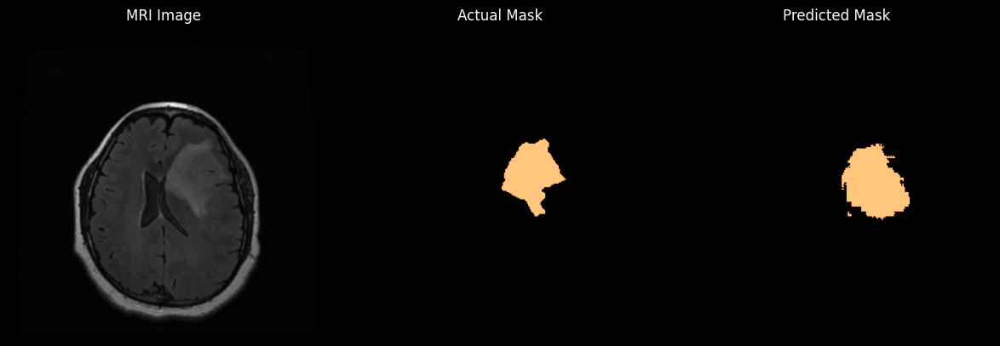

IoU: tensor([[0.6198]])


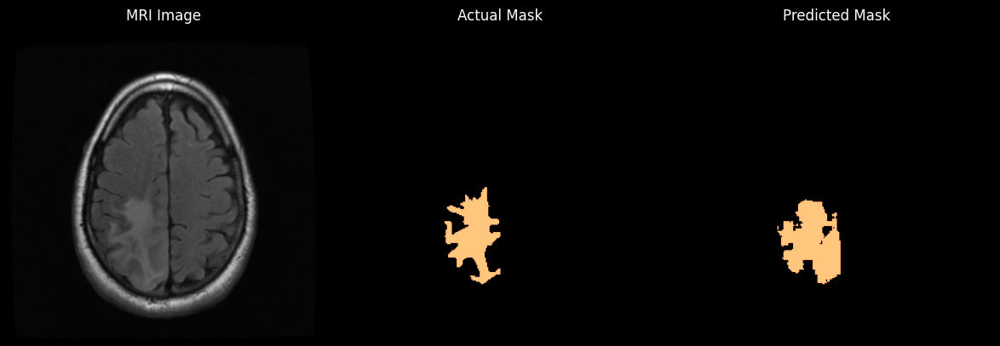

IoU: tensor([[0.8096]])


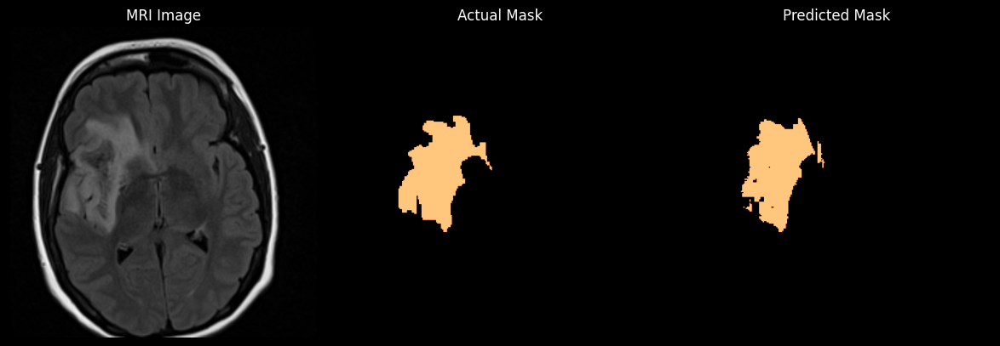

IoU: tensor([[0.5996]])


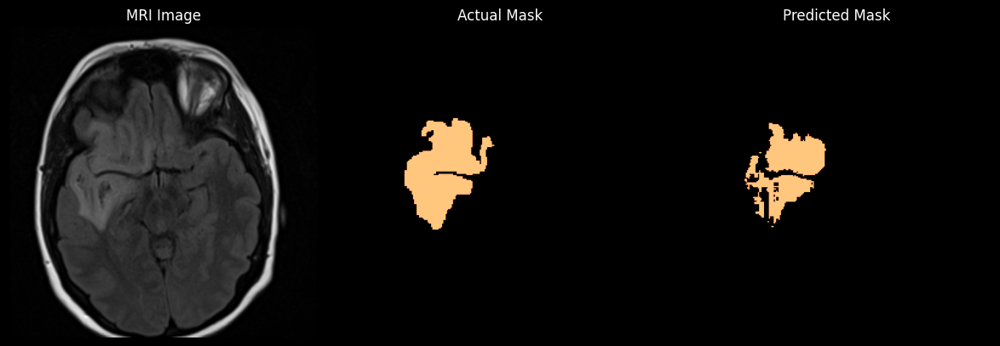

IoU: tensor([[0.1835]])


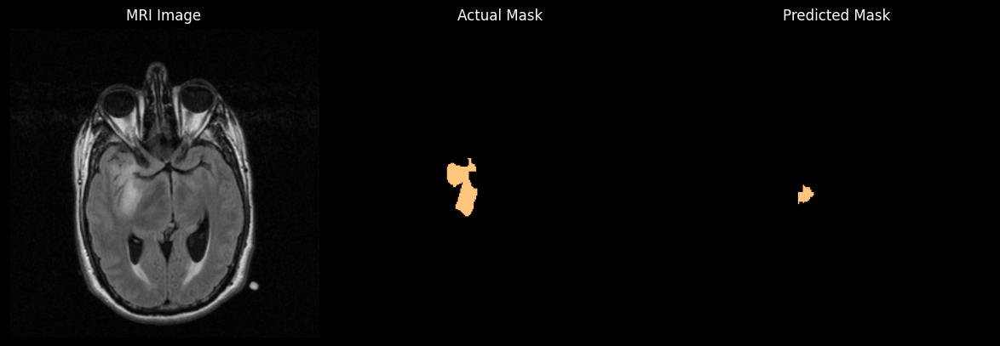

IoU: tensor([[0.5361]])


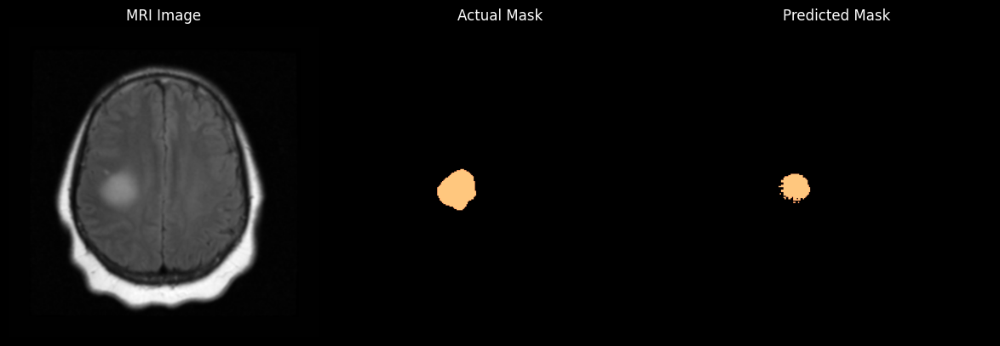

IoU: tensor([[0.3093]])


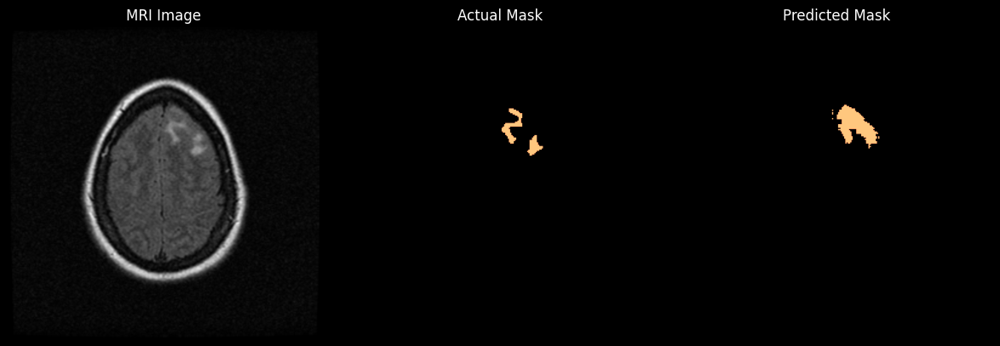

IoU: tensor([[0.4610]])


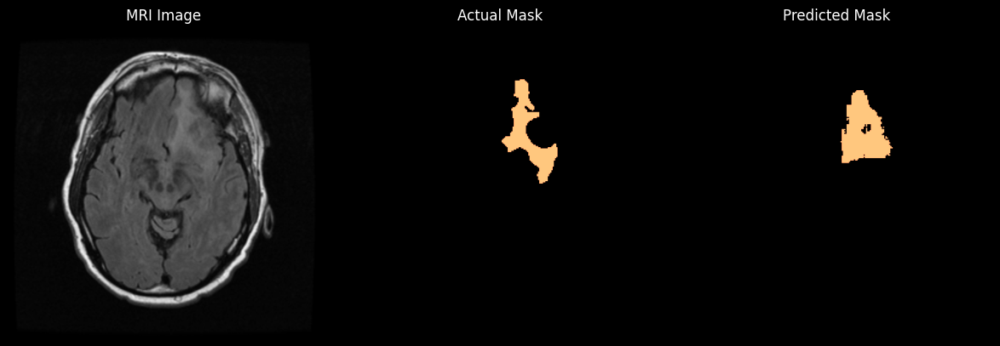

IoU: tensor([[0.3504]])


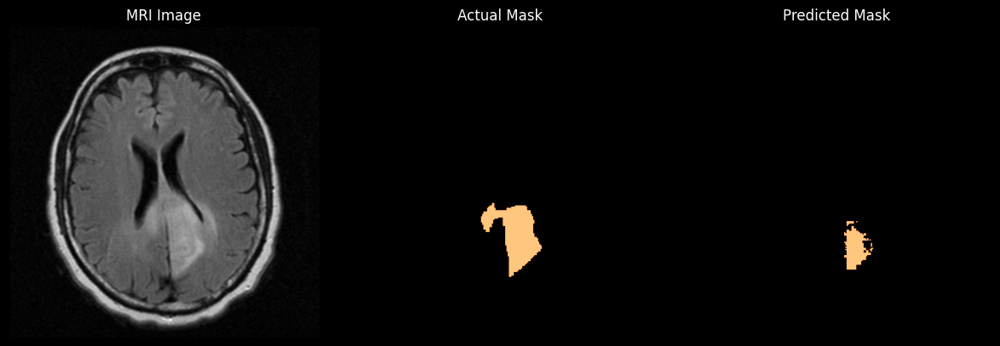

IoU: tensor([[0.7418]])


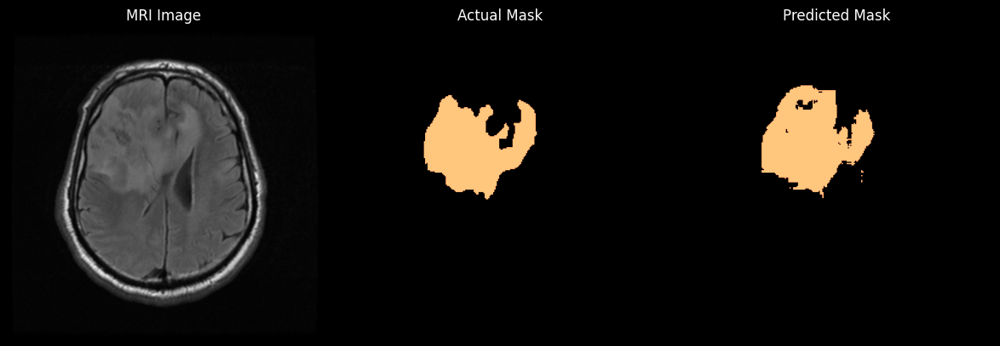

IoU: tensor([[0.9059]])


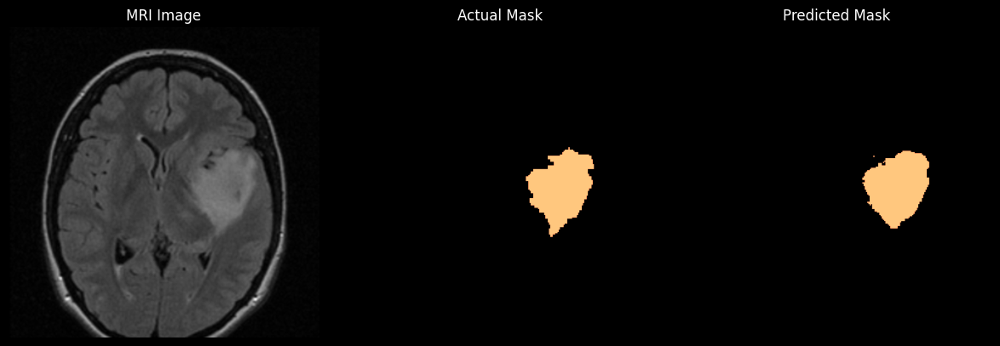

IoU: tensor([[0.8015]])


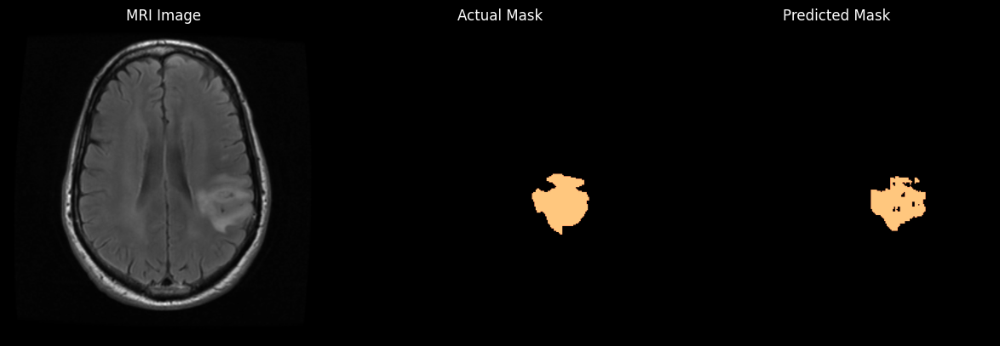

IoU: tensor([[0.7775]])


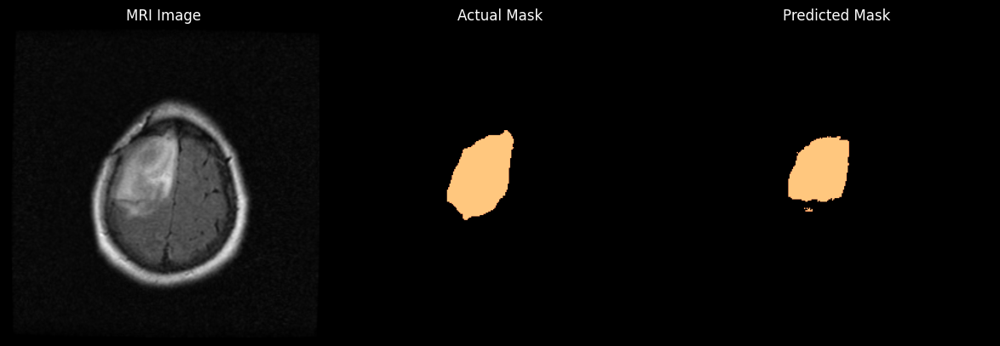

IoU: tensor([[0.1863]])


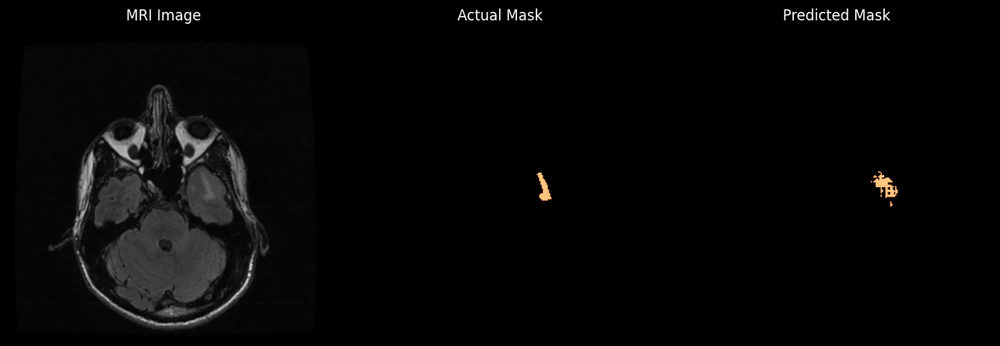

IoU: tensor([[0.0146]])


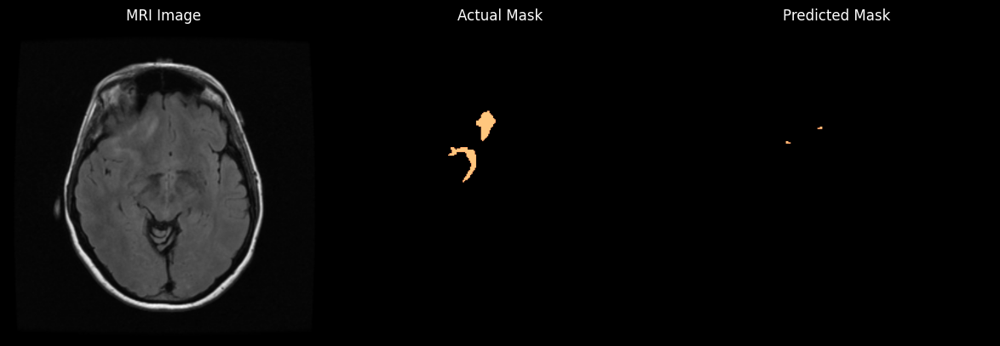

IoU: tensor([[0.2956]])


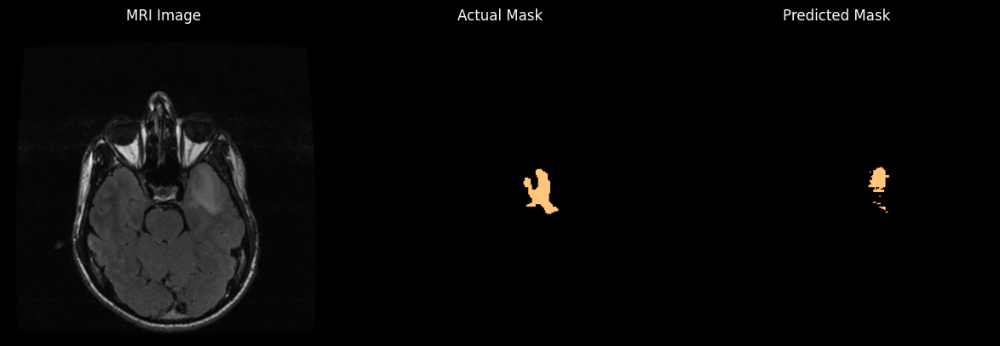

IoU: tensor([[0.8056]])


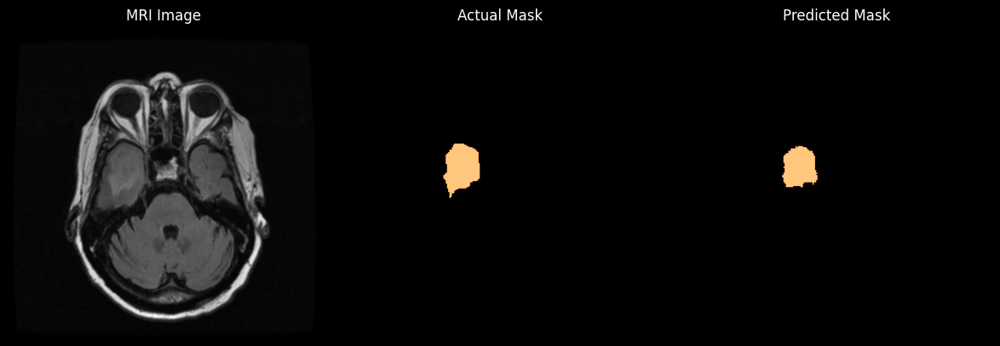

IoU: tensor([[0.5618]])


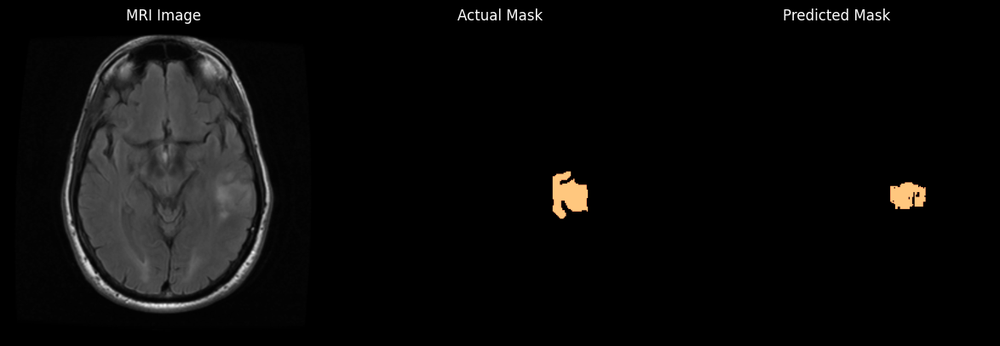

IoU: tensor([[0.9091]])


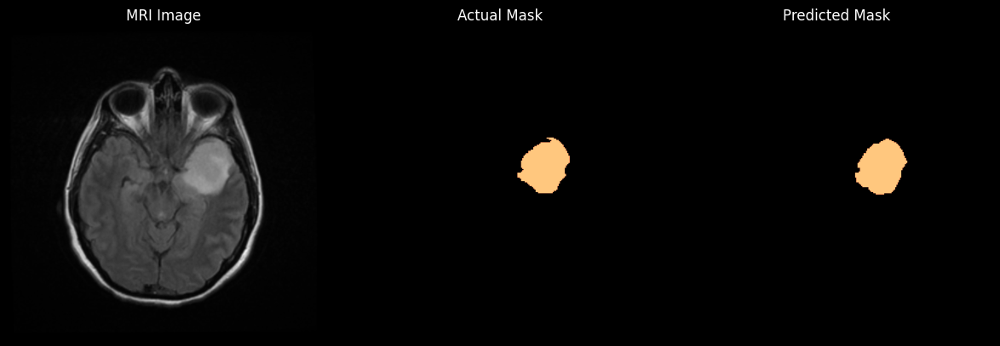

IoU: tensor([[0.8045]])


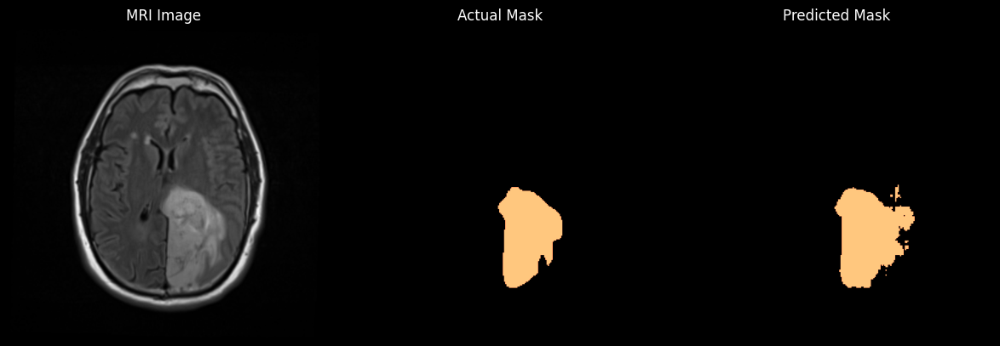

IoU: tensor([[0.9357]])


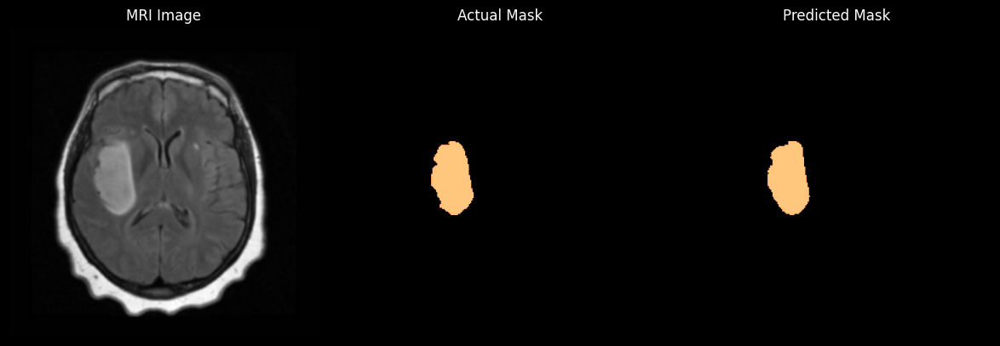

IoU: tensor([[0.6826]])


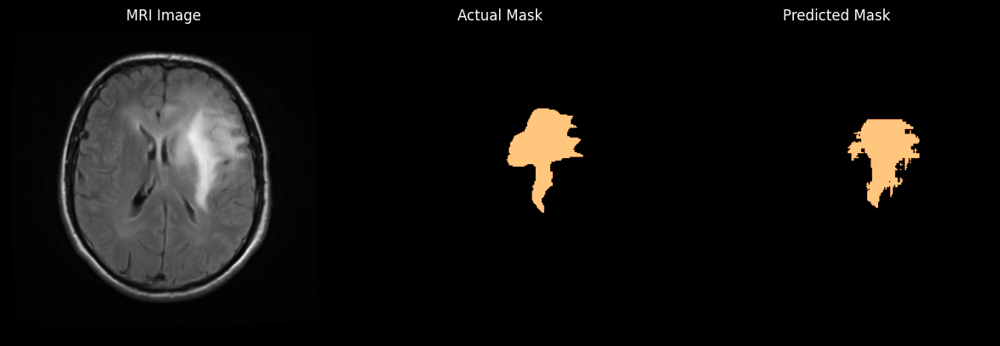

IoU: tensor([[0.7068]])


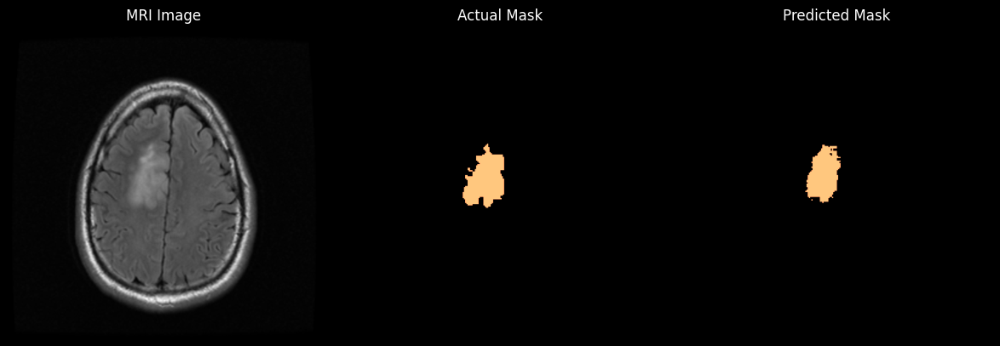

IoU: tensor([[0.8943]])


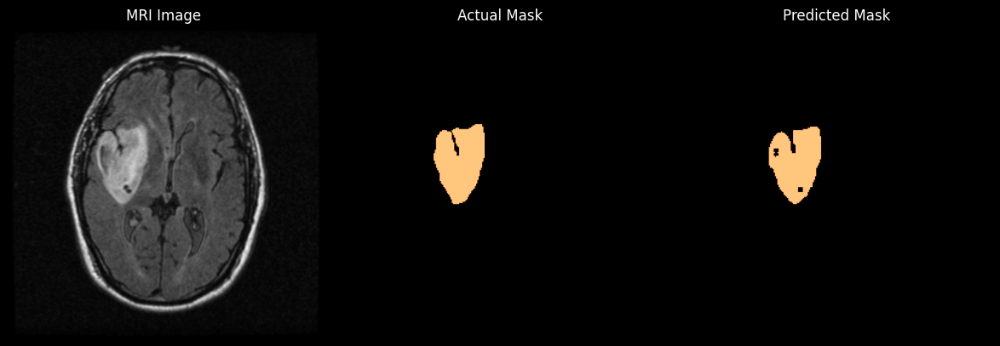

IoU: tensor([[0.0105]])


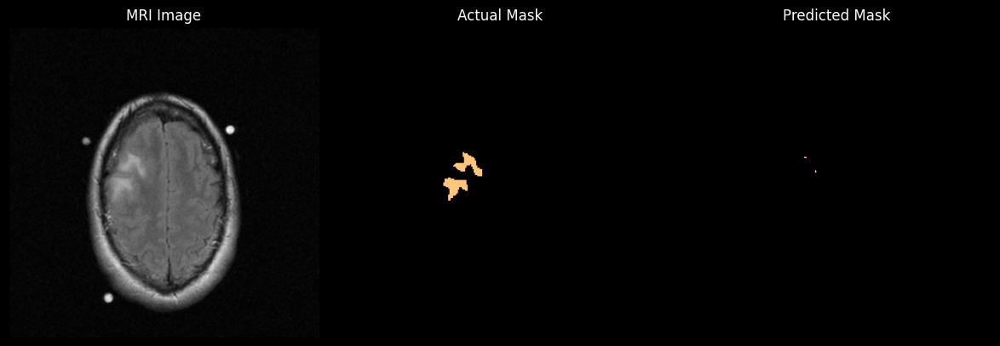

IoU: tensor([[0.8845]])


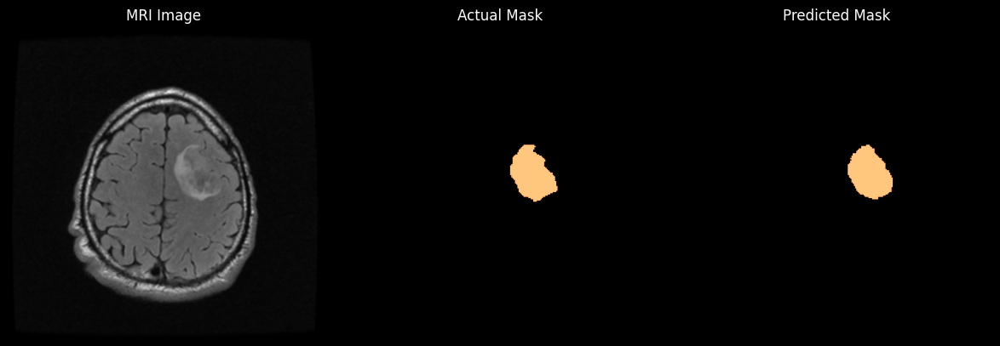

IoU: tensor([[0.]])


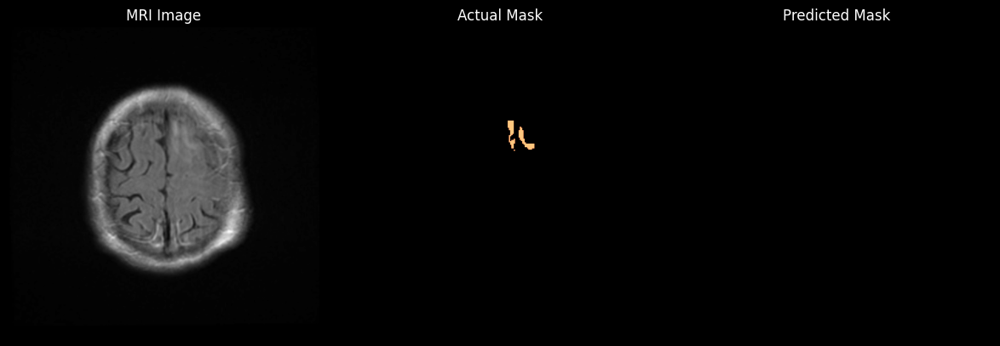

IoU: tensor([[0.5466]])


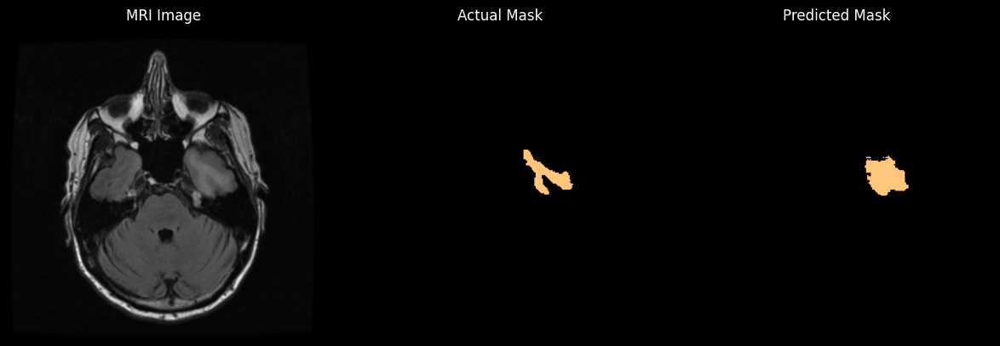

IoU: tensor([[0.8565]])


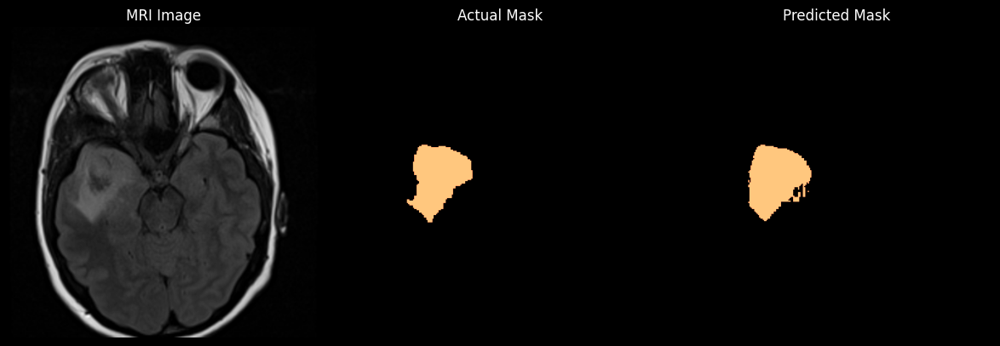

IoU: tensor([[0.0733]])


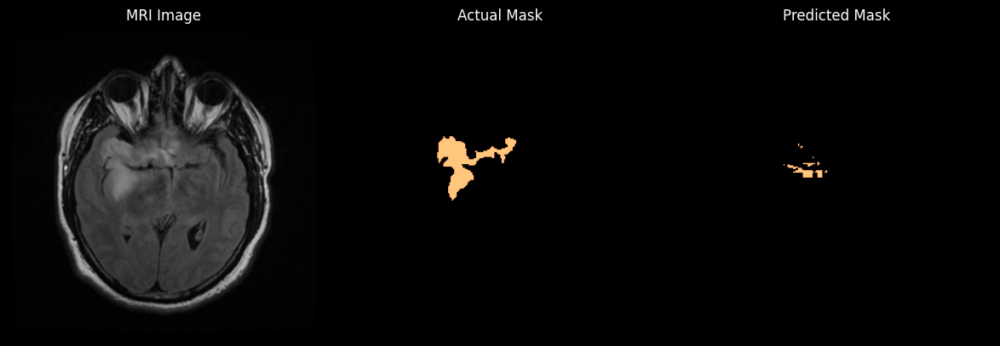

IoU: tensor([[0.9121]])


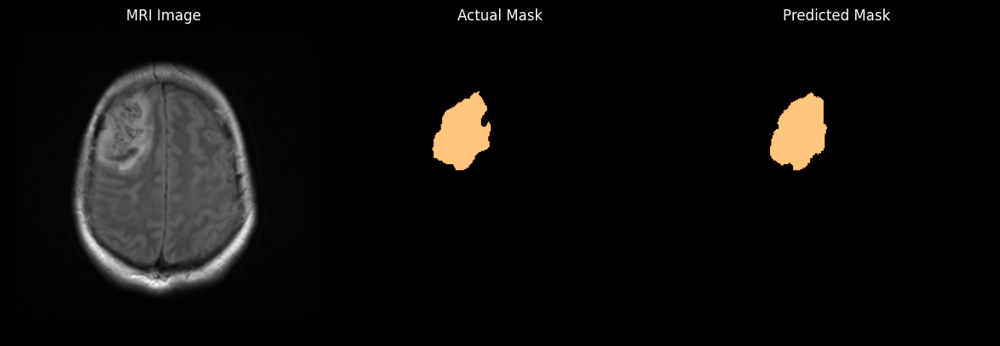

IoU: tensor([[0.6936]])


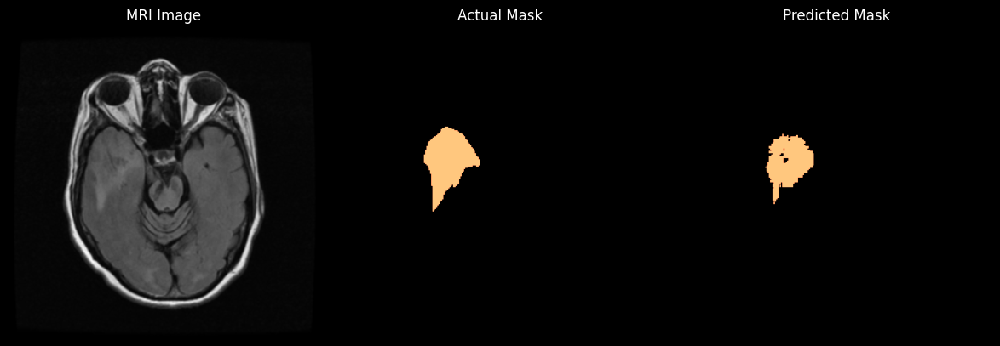

IoU: tensor([[0.0354]])


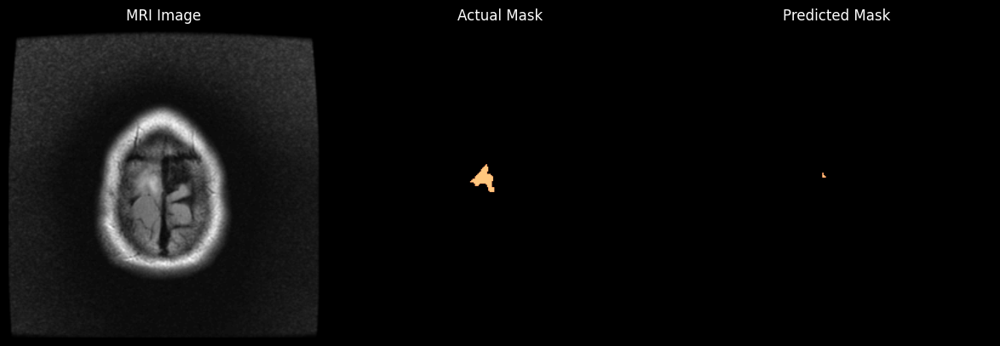

IoU: tensor([[0.7253]])


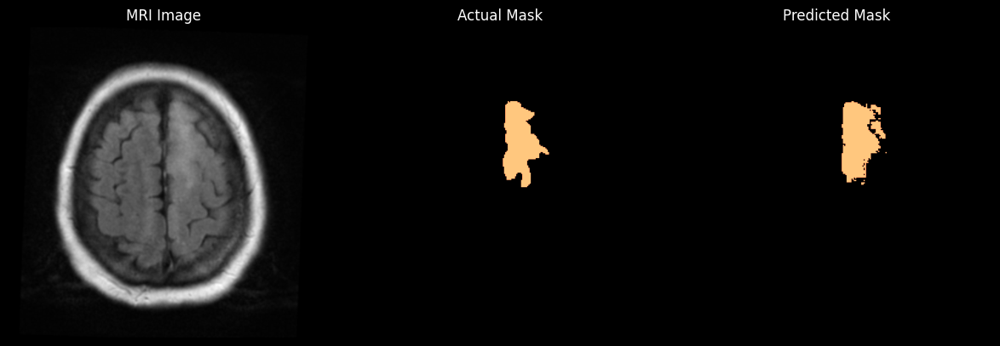

IoU: tensor([[0.6787]])


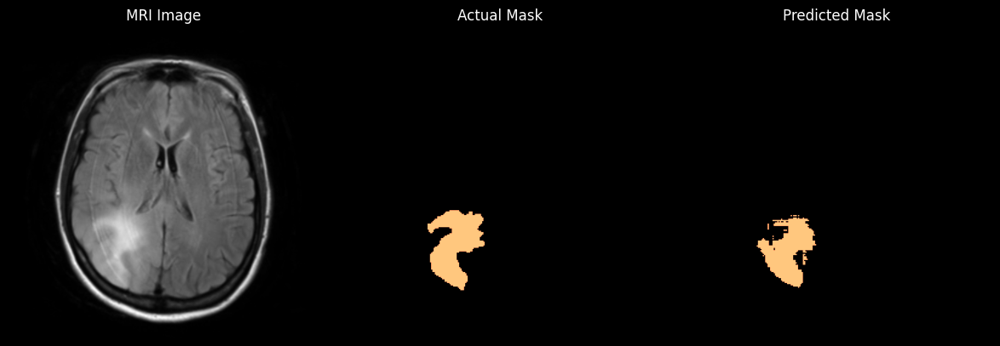

IoU: tensor([[0.9359]])


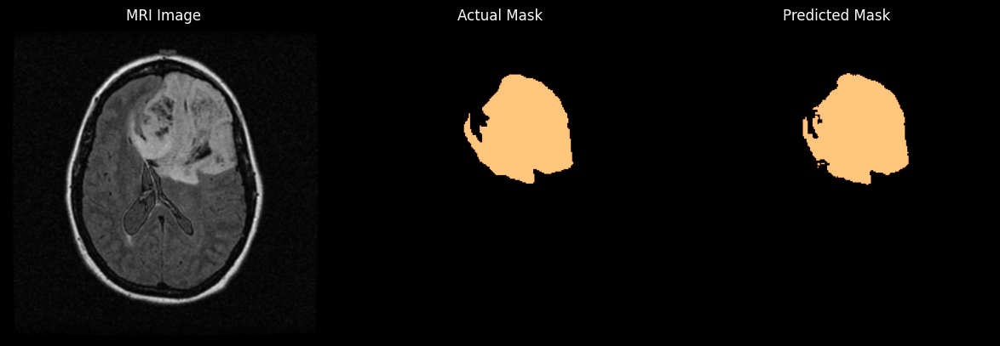

IoU: tensor([[0.8587]])


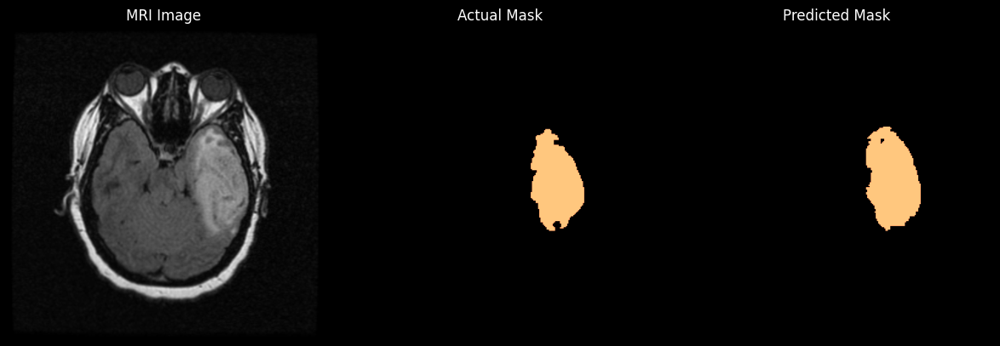

IoU: tensor([[0.2964]])


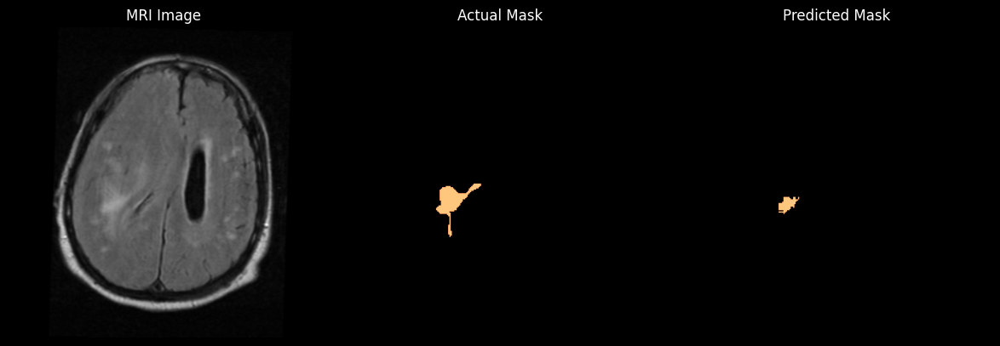

IoU: tensor([[0.9194]])


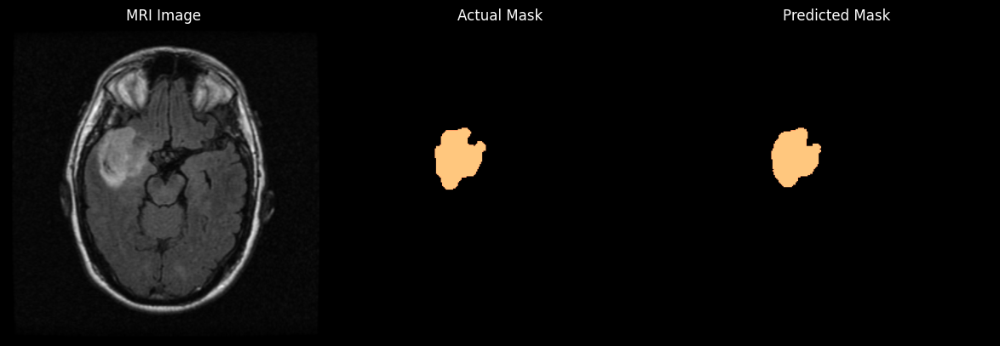

IoU: tensor([[0.6524]])


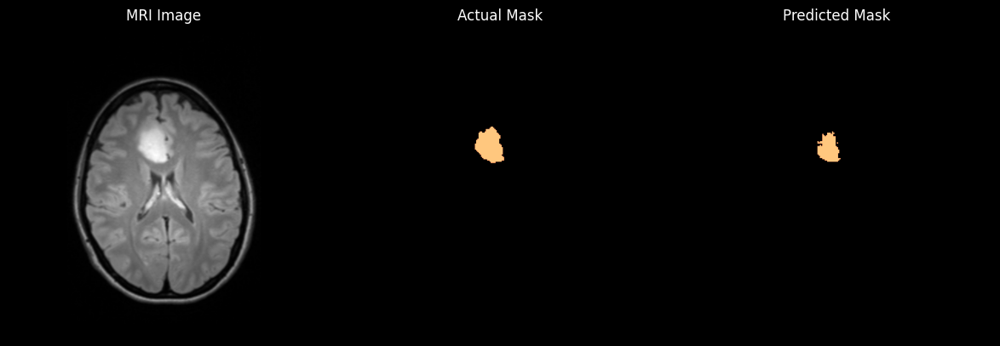

IoU: tensor([[0.5673]])


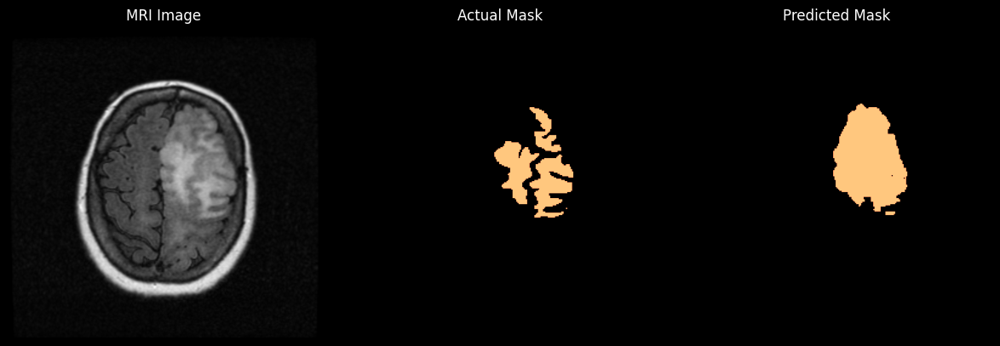

IoU: tensor([[0.7553]])


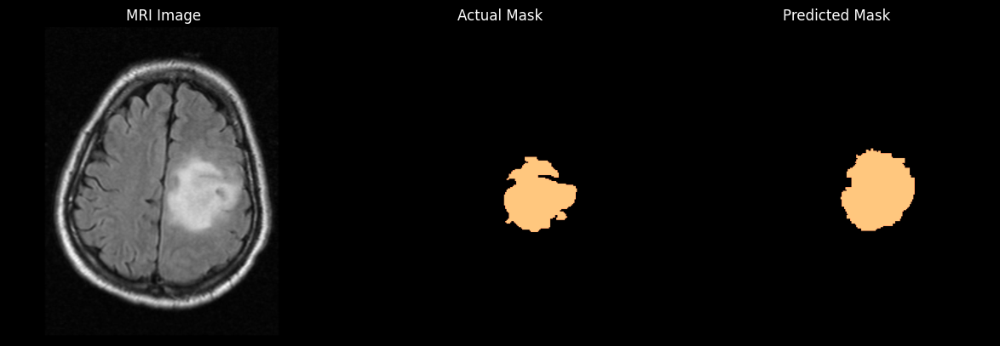

IoU: tensor([[0.3208]])


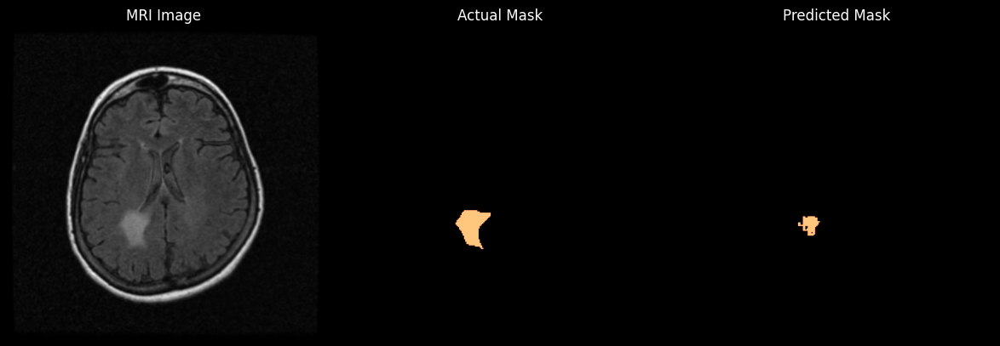

IoU: tensor([[0.4600]])


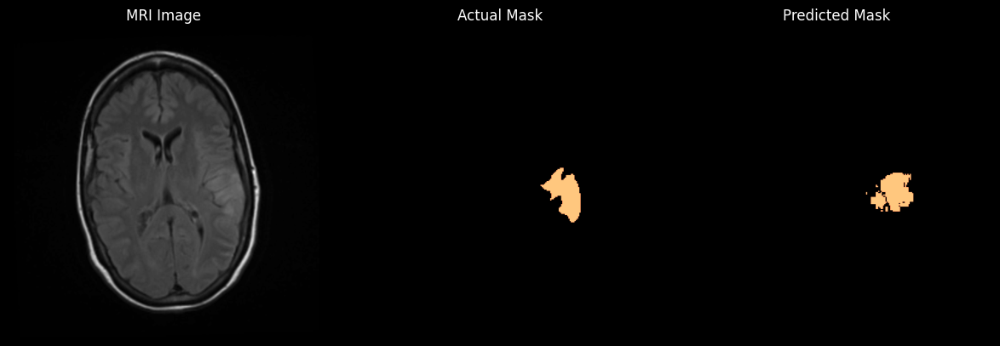

IoU: tensor([[0.0673]])


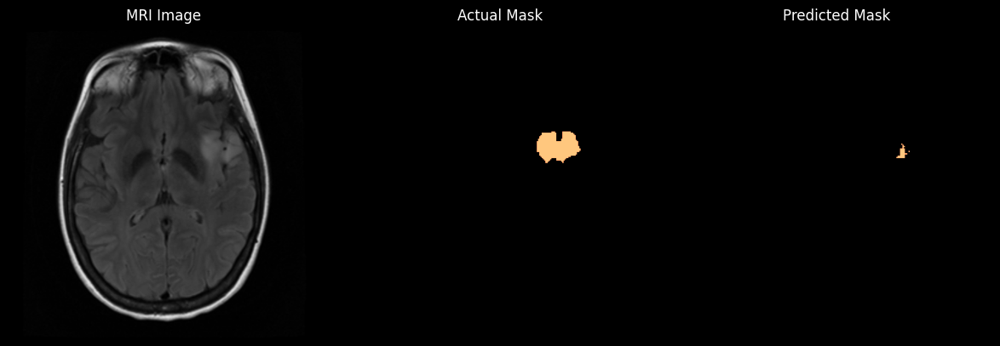

IoU: tensor([[0.9252]])


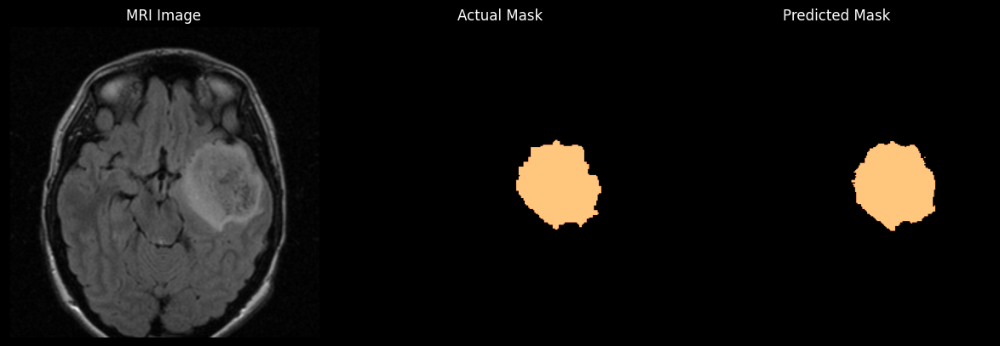

In [40]:
test_ious = []
model.eval()
# Iteratire through test images
with torch.no_grad():
    for batch in tqdm(test_dataloader):

        # forward pass
        outputs = model(pixel_values=batch["pixel_values"].cuda(),
                      input_boxes=batch["input_boxes"].cuda(),
                      multimask_output=False)

        ground_truth_masks = batch["ground_truth_mask"].float().cuda()

        # apply sigmoid
        sam_mask_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
        sam_mask_prob = sam_mask_prob.cpu().numpy().squeeze()
        sam_mask = (sam_mask_prob > 0.5)

        iou = compute_iou(torch.from_numpy(sam_mask).reshape(1, 256, 256).unsqueeze(1).cpu(),
                          ground_truth_masks.unsqueeze(1).cpu(), ignore_empty=False)

        print(f'IoU: {iou}')
        test_ious.append(iou)

        plt.figure(figsize=(12,4))
        plt.subplot(1,3,1)
        plt.imshow(batch["pixel_values"][0,1], cmap='gray')
        plt.title('MRI Image')
        plt.axis('off')
        
        plt.subplot(1,3,2)
        plt.imshow(batch["ground_truth_mask"][0], cmap='copper')
        plt.title('Actual Mask')
        plt.axis('off')
        
        plt.subplot(1,3,3)
        plt.imshow(sam_mask, cmap='copper')
        plt.title('Predicted Mask')
        plt.axis('off')
        
        plt.tight_layout()
        plt.show()

## Inference with Known Bounding Box

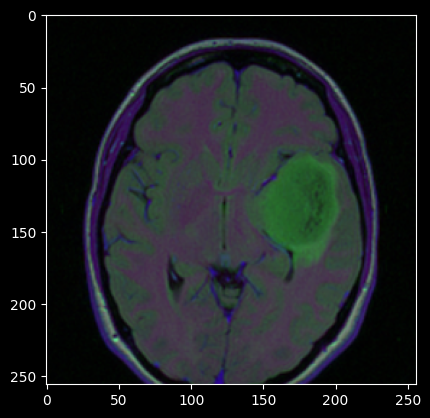

In [41]:
# let's take a random training example
idx = 10

# load image
image = test_dataset[idx]["image"]
plt.imshow(np.array(image))

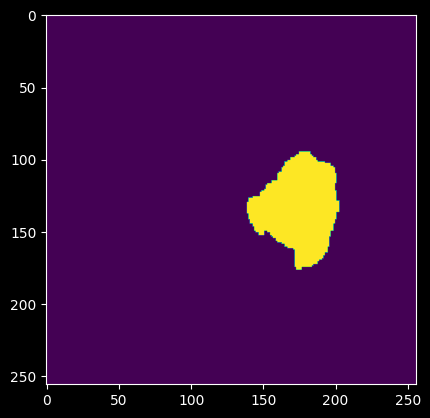

In [42]:
plt.imshow(np.array(test_dataset[idx]["mask"]))

In [43]:
# get box prompt based on ground truth segmentation map
ground_truth_mask = np.array(test_dataset[idx]["mask"])
prompt = get_bounding_box(ground_truth_mask)

# prepare image + box prompt for the model
inputs = processor(image, input_boxes=[[prompt]], return_tensors="pt").to(device)
for k,v in inputs.items():
  print(k,v.shape)

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_boxes torch.Size([1, 1, 4])


(-0.5, 255.5, 255.5, -0.5)

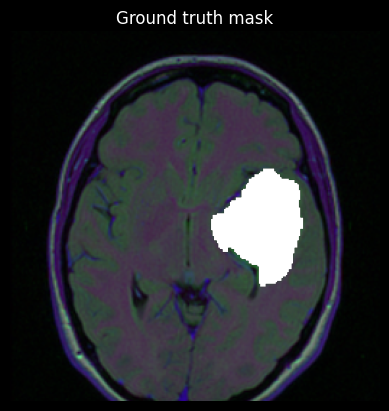

In [44]:
fig, axes = plt.subplots()

axes.imshow(np.array(image))
show_mask(ground_truth_mask, axes)
axes.title.set_text(f"Ground truth mask")
axes.axis("off")

In [45]:
model.eval()

# forward pass
with torch.no_grad():
  outputs = model(**inputs, multimask_output=False)

In [46]:
# apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5)

(-0.5, 255.5, 255.5, -0.5)

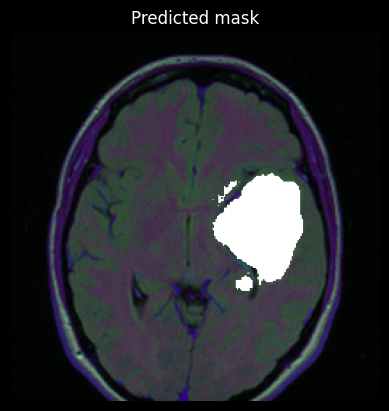

In [47]:
def show_mask(mask, ax, random_color=False):
    if random_color:
        color = np.concatenate([np.random.random(3), np.array([0.6])], axis=0)
    else:
        color = np.array([255, 255, 255, 255])
    h, w = mask.shape[-2:]
    mask_image = mask.reshape(h, w, 1) * color.reshape(1, 1, -1)
    ax.imshow(mask_image)

fig, axes = plt.subplots()

axes.imshow(np.array(image))
show_mask(medsam_seg, axes)
axes.title.set_text(f"Predicted mask")
axes.axis("off")

In [48]:
predicted_masks = outputs.pred_masks.squeeze(1) # perlu diubah ke sigmoid
ground_truth_masks = batch["ground_truth_mask"].float().to(device)

sam_masks_prob = torch.sigmoid(predicted_masks)
sam_masks_prob = sam_masks_prob.squeeze()
sam_masks = (sam_masks_prob > 0.5)

In [49]:
pred = torch.from_numpy(medsam_seg).float()

In [50]:
act = torch.from_numpy(ground_truth_mask).float()

In [51]:
iou = compute_iou(act/255, pred)

iou

tensor(0.8721)

## Inference with Unknown Bounding Box

### Prompt: Grid of Points

In [52]:

"""
input_points (torch.FloatTensor of shape (batch_size, num_points, 2)) —
Input 2D spatial points, this is used by the prompt encoder to encode the prompt.
Generally yields to much better results. The points can be obtained by passing a
list of list of list to the processor that will create corresponding torch tensors
of dimension 4. The first dimension is the image batch size, the second dimension
is the point batch size (i.e. how many segmentation masks do we want the model to
predict per input point), the third dimension is the number of points per segmentation
mask (it is possible to pass multiple points for a single mask), and the last dimension
is the x (vertical) and y (horizontal) coordinates of the point. If a different number
of points is passed either for each image, or for each mask, the processor will create
“PAD” points that will correspond to the (0, 0) coordinate, and the computation of the
embedding will be skipped for these points using the labels.

"""
# Define the size of your array
array_size = 256

# Define the size of your grid
grid_size = 10

# Generate the grid points
x = np.linspace(0, array_size-1, grid_size)
y = np.linspace(0, array_size-1, grid_size)

# Generate a grid of coordinates
xv, yv = np.meshgrid(x, y)

# Convert the numpy arrays to lists
xv_list = xv.tolist()
yv_list = yv.tolist()

# Combine the x and y coordinates into a list of list of lists
input_points = [[[int(x), int(y)] for x, y in zip(x_row, y_row)] for x_row, y_row in zip(xv_list, yv_list)]

#We need to reshape our nxn grid to the expected shape of the input_points tensor
# (batch_size, point_batch_size, num_points_per_image, 2),
# where the last dimension of 2 represents the x and y coordinates of each point.
#batch_size: The number of images you're processing at once.
#point_batch_size: The number of point sets you have for each image.
#num_points_per_image: The number of points in each set.
input_points = torch.tensor(input_points).view(1, 1, grid_size*grid_size, 2)

In [53]:
image = test_dataset[-1]["image"]
ground_truth_mask = np.array(test_dataset[-1]["mask"])

# prepare image + box prompt for the model
inputs = processor(image, input_points=input_points, return_tensors="pt").to(device)
for k,v in inputs.items():
  print(k,v.shape)

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_points torch.Size([1, 1, 100, 2])


In [54]:
model.eval()

# forward pass
with torch.no_grad():
  outputs = model(**inputs, multimask_output=False)

In [55]:
# apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5)

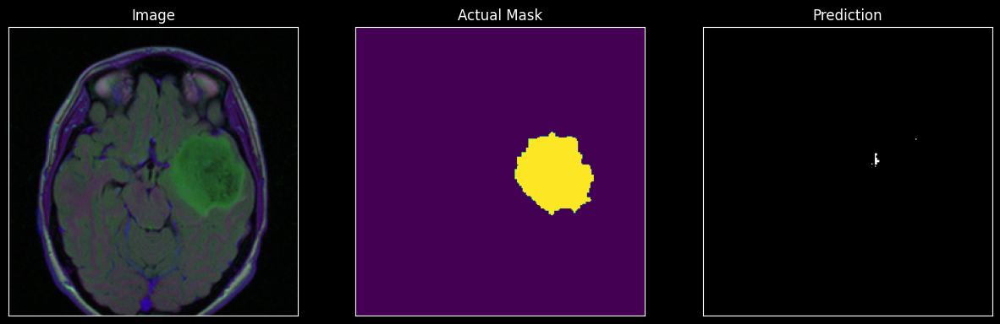

In [56]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the first image on the left
axes[0].imshow(np.array(image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(ground_truth_mask)  # Assuming the second image is grayscale
axes[1].set_title("Actual Mask")

# Plot the second image on the right
axes[2].imshow(medsam_seg, cmap='gray')  # Assuming the second image is grayscale
axes[2].set_title("Prediction")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()

In [57]:
pred = torch.from_numpy(medsam_seg).float()

In [58]:
act = torch.from_numpy(ground_truth_mask).float()

In [59]:
iou = compute_iou(act/255, pred, ignore_empty=False)

iou

tensor(0.0070)

### Prompt: Bounding Box in Image

In [60]:
# Function to draw a bounding box around the object in an image
def draw_bounding_box(image):
    # Load the image
    # image = cv2.imread(image_path)

    # Convert the image to gray scale
    gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

    # Apply a blur to the image to reduce noise
    blurred = cv2.GaussianBlur(gray, (5, 5), 0)

    # Threshold the image to get the object in binary
    _, thresh = cv2.threshold(blurred, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

    # Find contours in the thresholded image
    contours, _ = cv2.findContours(thresh, cv2.RETR_TREE, cv2.CHAIN_APPROX_SIMPLE)

    # Find the largest contour, assuming the object to bound is the largest one
    largest_contour = max(contours, key=cv2.contourArea)

    # Draw a bounding box around the largest contour
    x, y, w, h = cv2.boundingRect(largest_contour)
    cv2.rectangle(image, (x, y), (x + w, y + h), (0, 255, 0), 2)

    plt.imshow(image)

    x_min = x
    x_max = x + w
    y_min = y
    y_max = y + h

    return [x_min, y_min, x_max, y_max]


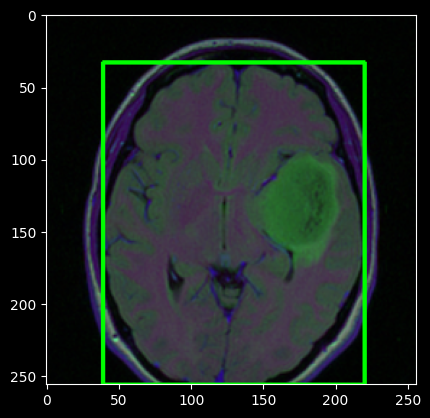

In [61]:
pr = draw_bounding_box(np.array(test_dataset[10]["image"]))

In [62]:
image = test_dataset[10]["image"]
ground_truth_mask = np.array(test_dataset[10]["mask"])

# prepare image + box prompt for the model
inputs = processor(image, input_boxes=[[pr]], return_tensors="pt").to(device)
for k,v in inputs.items():
  print(k,v.shape)

pixel_values torch.Size([1, 3, 1024, 1024])
original_sizes torch.Size([1, 2])
reshaped_input_sizes torch.Size([1, 2])
input_boxes torch.Size([1, 1, 4])


In [63]:
model.eval()

# forward pass
with torch.no_grad():
  outputs = model(**inputs, multimask_output=False)

In [64]:
# apply sigmoid
medsam_seg_prob = torch.sigmoid(outputs.pred_masks.squeeze(1))
# convert soft mask to hard mask
medsam_seg_prob = medsam_seg_prob.cpu().numpy().squeeze()
medsam_seg = (medsam_seg_prob > 0.5)

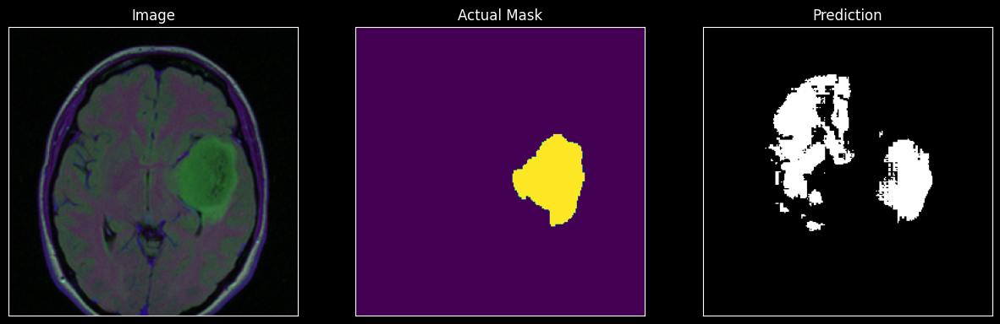

In [65]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5))

# Plot the first image on the left
axes[0].imshow(np.array(image), cmap='gray')  # Assuming the first image is grayscale
axes[0].set_title("Image")

# Plot the second image on the right
axes[1].imshow(ground_truth_mask)  # Assuming the second image is grayscale
axes[1].set_title("Actual Mask")

# Plot the second image on the right
axes[2].imshow(medsam_seg, cmap='gray')  # Assuming the second image is grayscale
axes[2].set_title("Prediction")

# Hide axis ticks and labels
for ax in axes:
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xticklabels([])
    ax.set_yticklabels([])

# Display the images side by side
plt.show()

In [66]:
pred = torch.from_numpy(medsam_seg).float()
act = torch.from_numpy(ground_truth_mask).float()
iou = compute_iou(act/255, pred, ignore_empty=False)

iou

tensor(0.2866)